## 02 - Analyze control and DT depleted Slc4a11-MCD/+ tumor cells
9/2/2024 - Data generated from Slc4a11-MCD mice DT treated for 2d, 7d; combined over two runs. Data submitted by Chun-Hao/EB on 9/19/23 and 11/14/23, analyzed by Jason 8/8/24 for Saline treated mice
Analyze global run on cellranger v6 data and create h5_ad files for further analysis

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib
from matplotlib import pyplot as plt

from pathlib import Path
import anndata

In [2]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
#names = load('genes.joblib')

In [3]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
#plt.rcParams['figure.figsize'] = (3,4)

In [4]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [5]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

## Load Tumor Cell Data

In [6]:
adata = load('write/combined_data.joblib')

## Select saline control mice

In [7]:
adata = adata[adata.obs.Group == 'Saline',:]

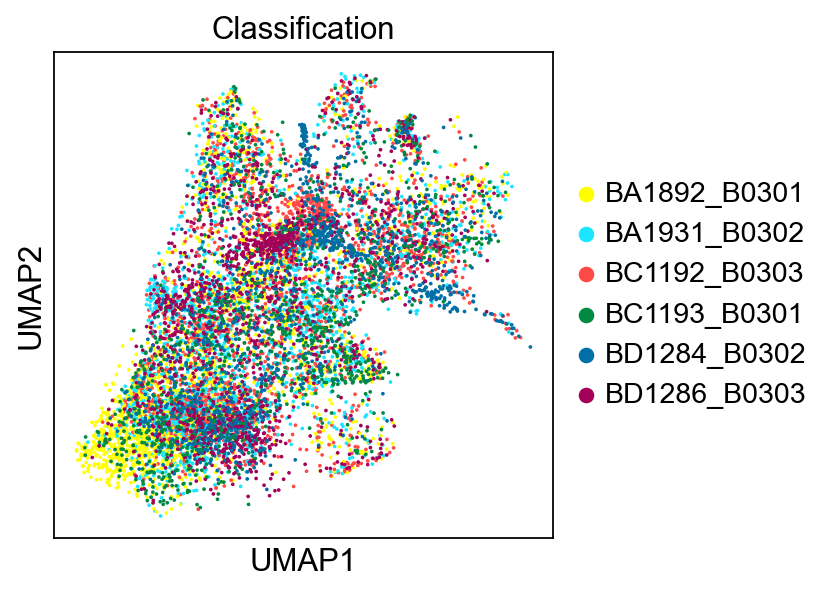

In [8]:
sc.pl.umap(adata, color=['Classification'])

## Define scoring Functions

In [9]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [10]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25,ctlgenes=25):
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [11]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/tools/_score_genes.py:169: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(


    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1393 total control genes are used. (0:00:02)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    999 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1289 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1297 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1592 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Gm6139'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1795 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    1090 total control 

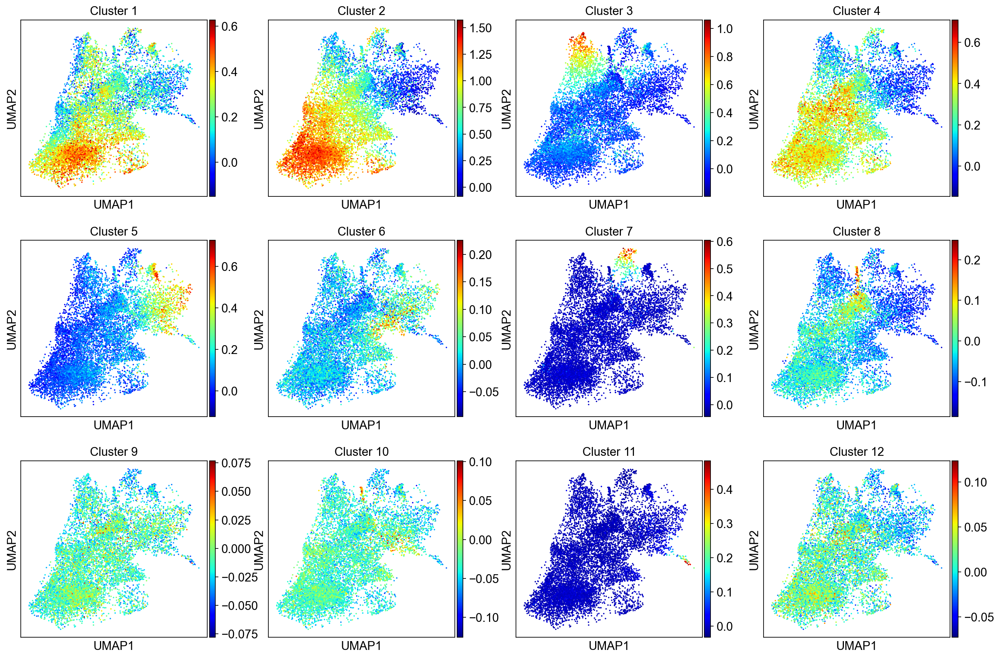

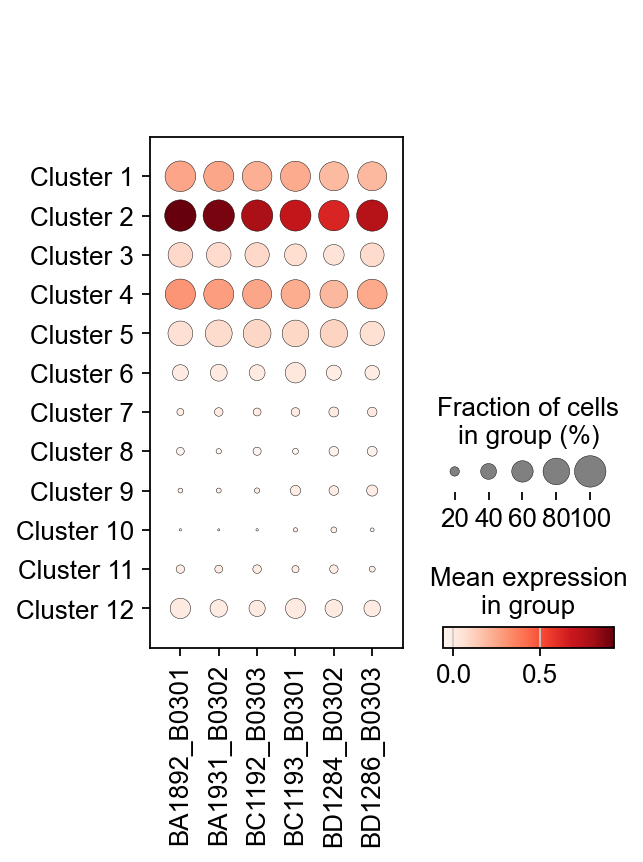

In [12]:
scoreAndPlot(adata, numgenes=100)

## Investigate the neighborhood graph

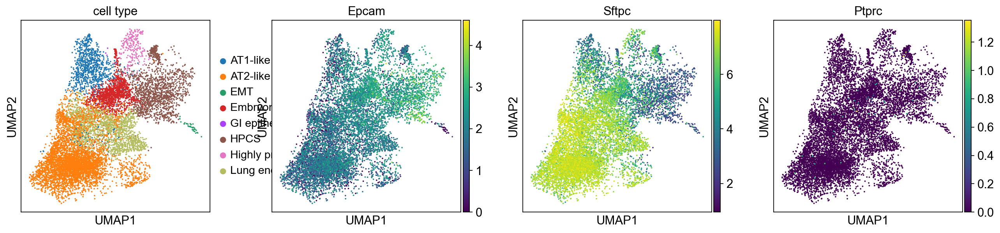

(None,)

In [13]:
sc.pl.umap(adata, color=['cell type', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

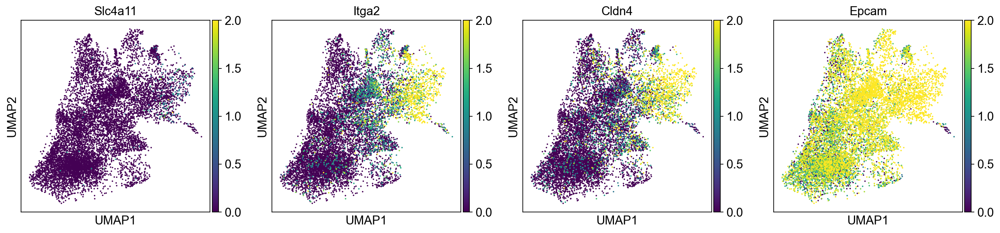

In [14]:
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4','Epcam'], vmax=2) #'Tigit', 

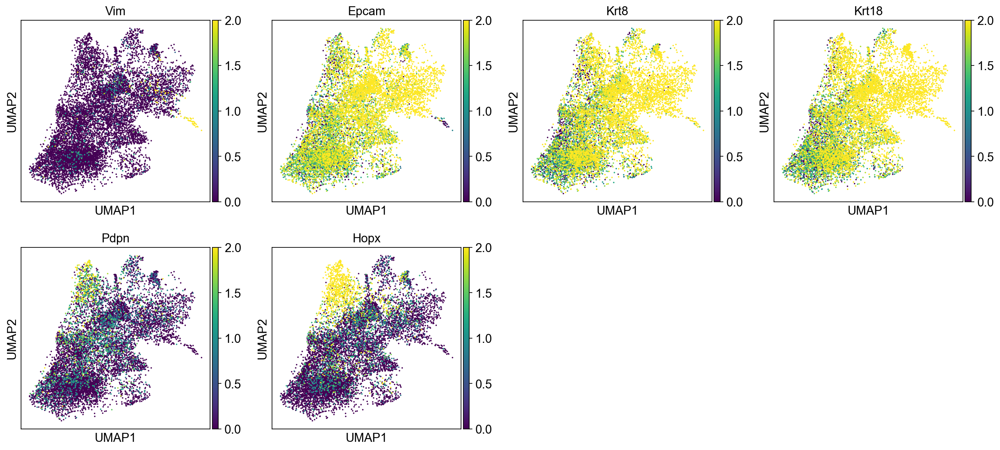

In [15]:
sc.pl.umap(adata, color=['Vim', 'Epcam', 'Krt8', 'Krt18', 'Pdpn', 'Hopx'], vmax=2) #'Pecam1',

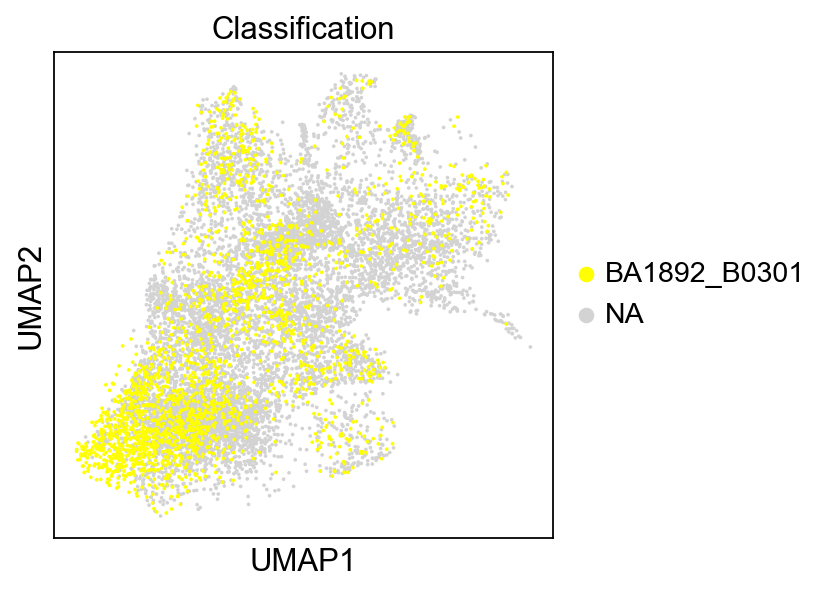

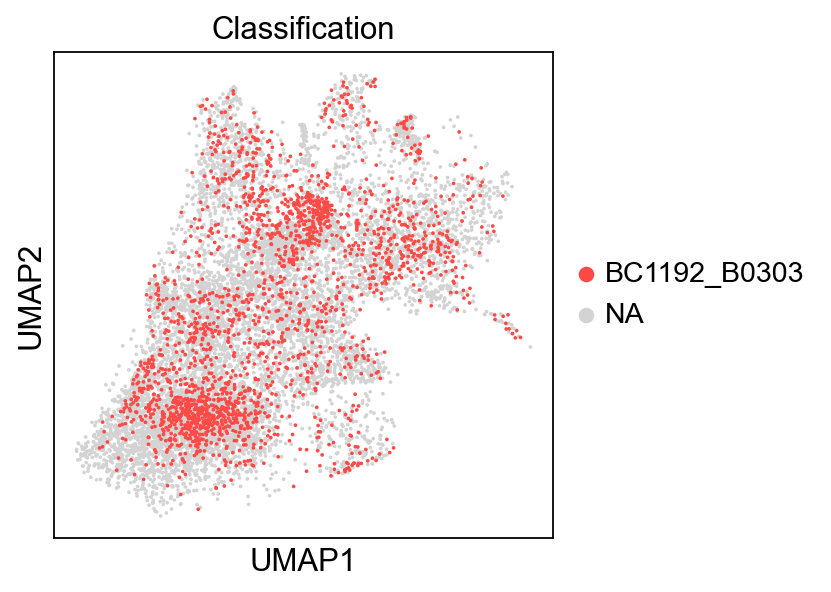

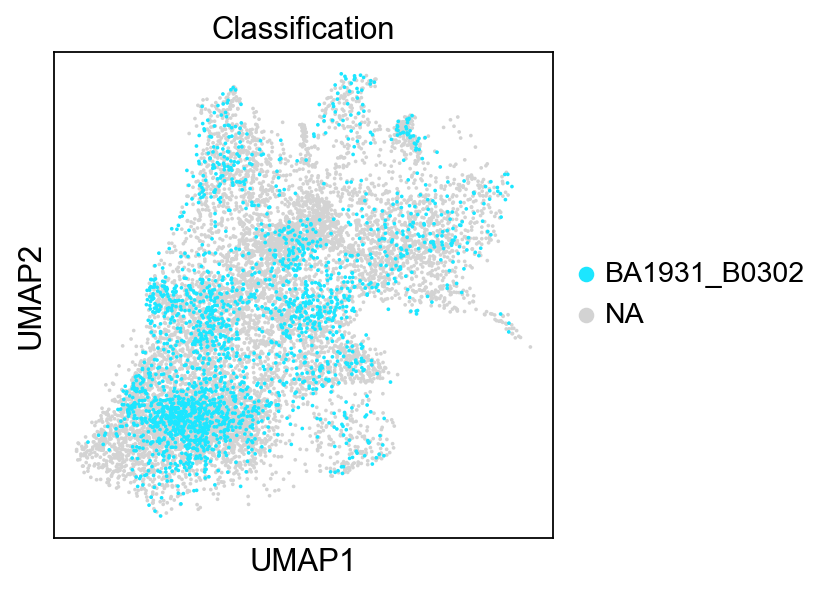

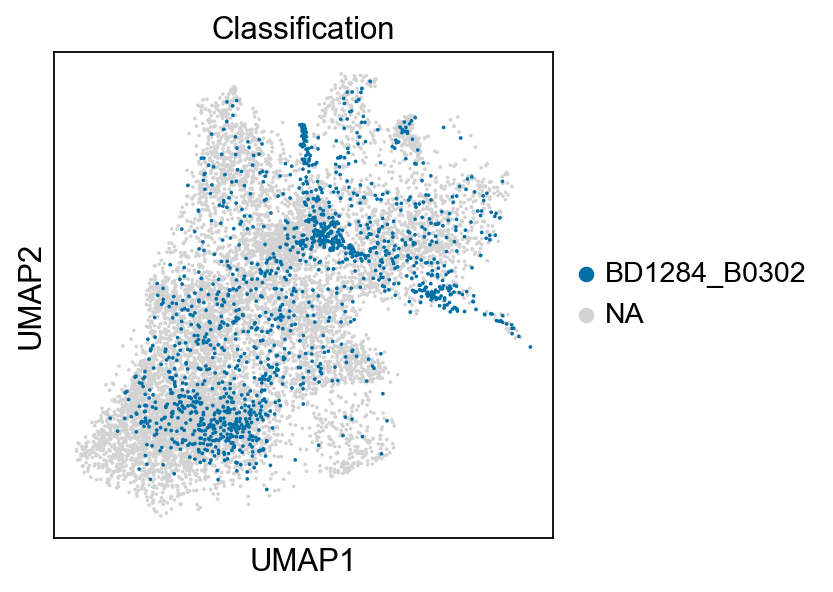

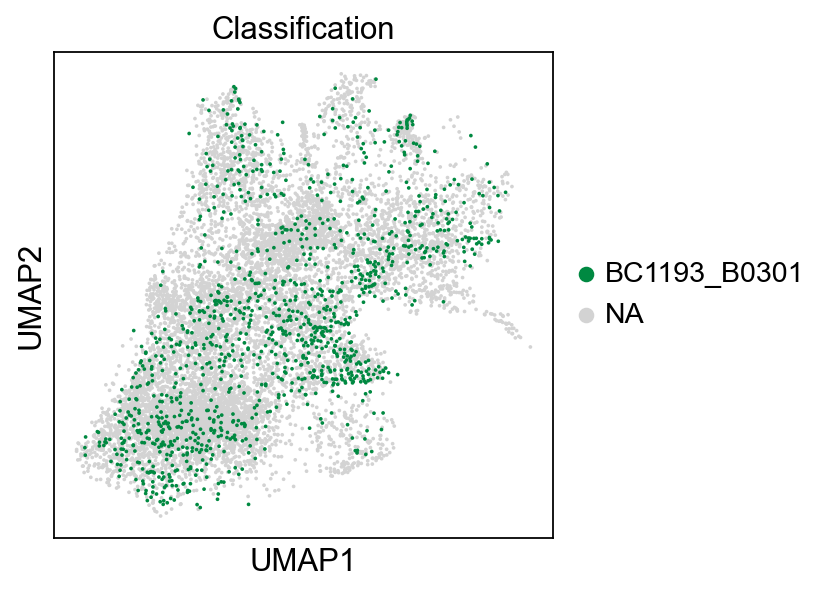

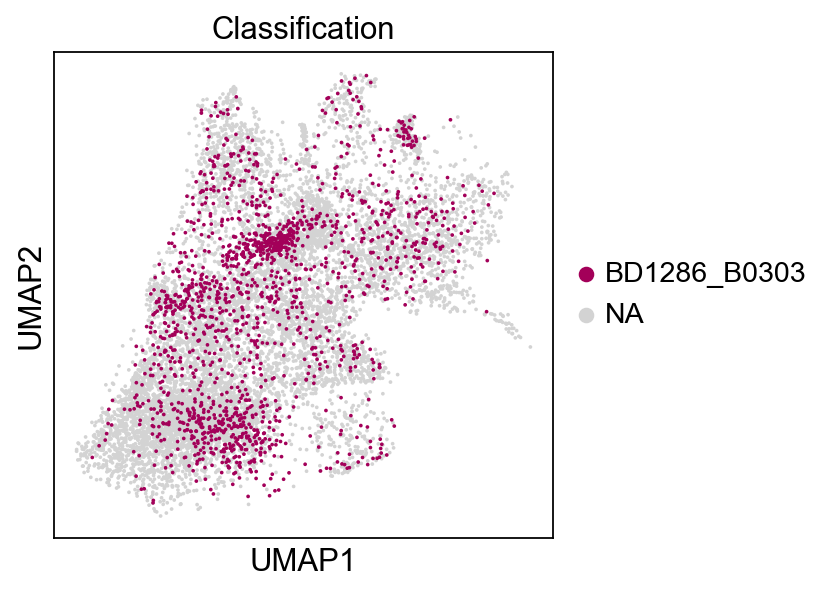

In [16]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

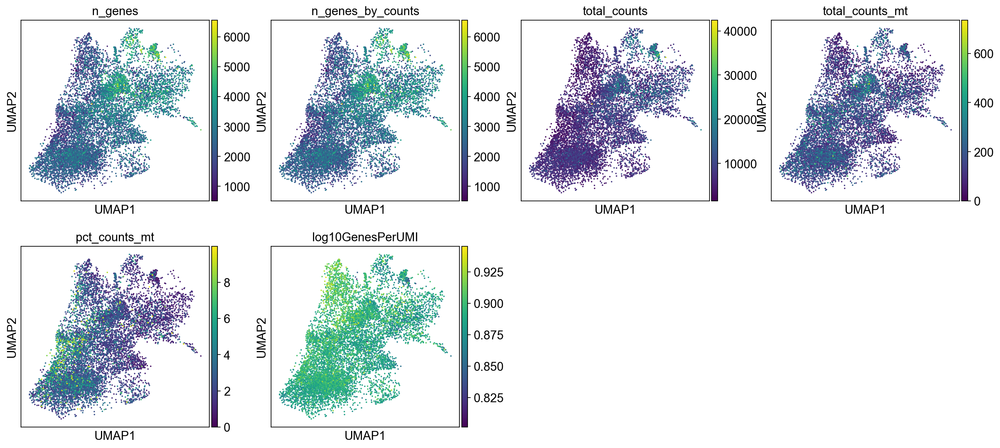

In [17]:
sc.pl.umap(adata,color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

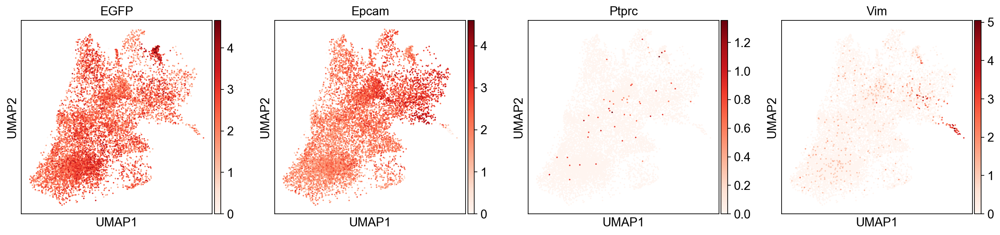

In [18]:
sc.pl.umap(adata, color=['EGFP','Epcam','Ptprc','Vim'],cmap="Reds")

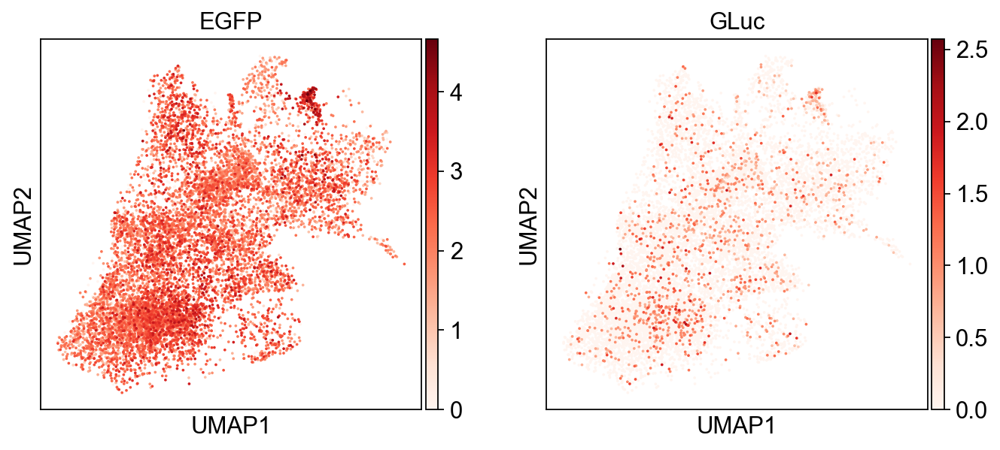

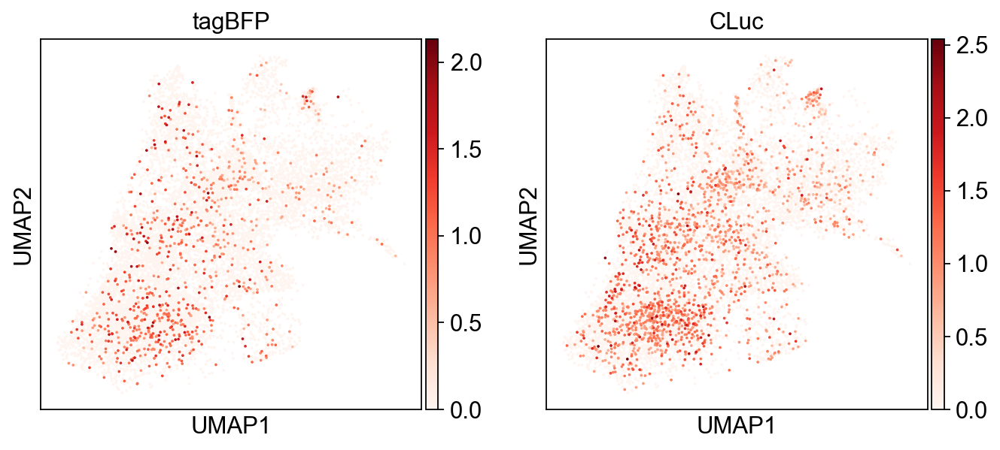

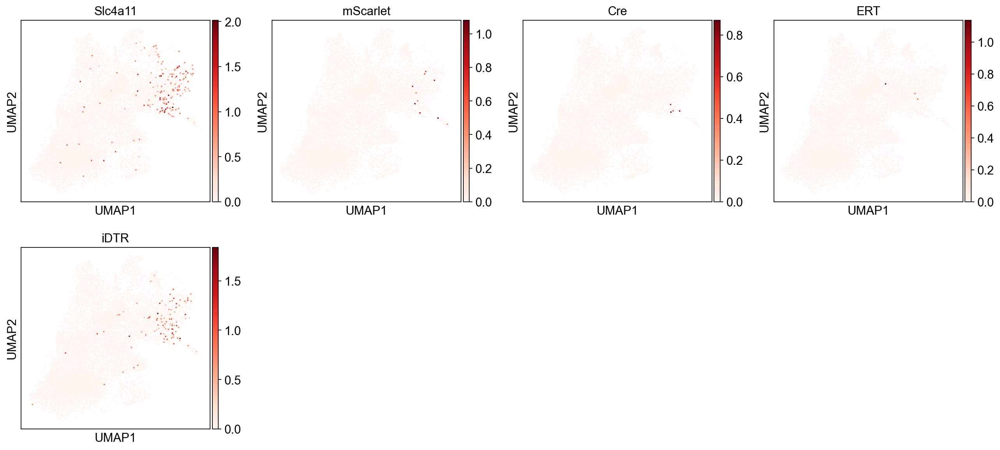

In [19]:
sc.pl.umap(adata, color=['EGFP','GLuc'], cmap='Reds')
sc.pl.umap(adata, color=['tagBFP','CLuc'], cmap='Reds')
sc.pl.umap(adata, color=['Slc4a11','mScarlet','Cre','ERT','iDTR'], cmap='Reds')

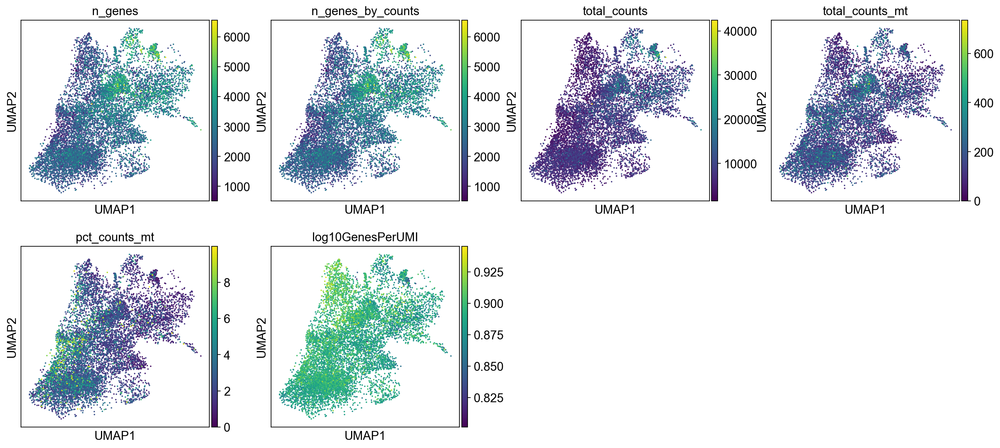

In [20]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

In [21]:
sc.tl.embedding_density(adata, basis='umap', groupby='batch_subgroup')

computing density on 'umap'
--> added
    'umap_density_batch_subgroup', densities (adata.obs)
    'umap_density_batch_subgroup_params', parameter (adata.uns)


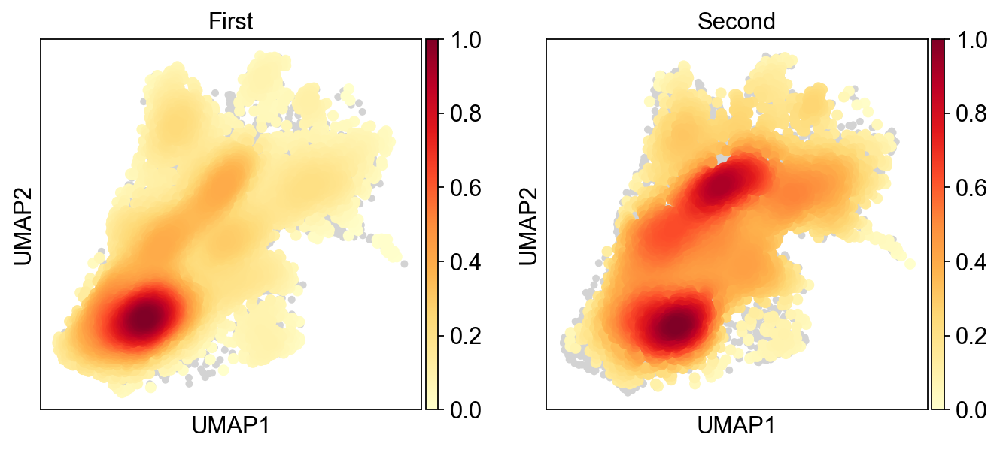

In [22]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_batch_subgroup')

## Compare against Marjanovic*, Hofree*, Chan* et al., Cancer Cell 2020 clusters

In [23]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']

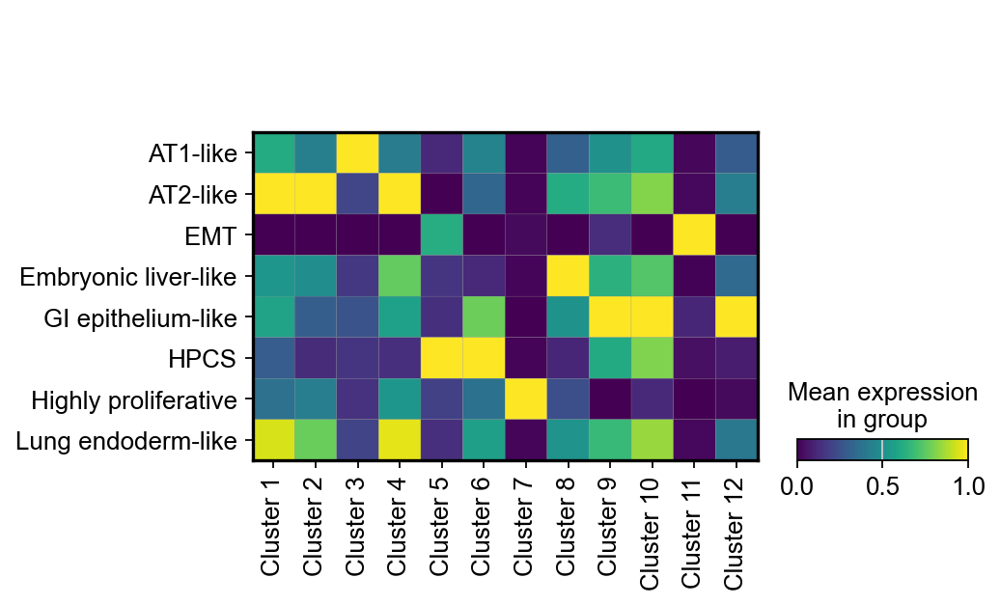

In [24]:
sc.pl.matrixplot(adata, cancerCell, 'cell type', standard_scale='var')

## Examine Batches and Clusters

In [25]:
sc.tl.embedding_density(adata,basis='umap', groupby='batch_subgroup')

computing density on 'umap'
--> added
    'umap_density_batch_subgroup', densities (adata.obs)
    'umap_density_batch_subgroup_params', parameter (adata.uns)


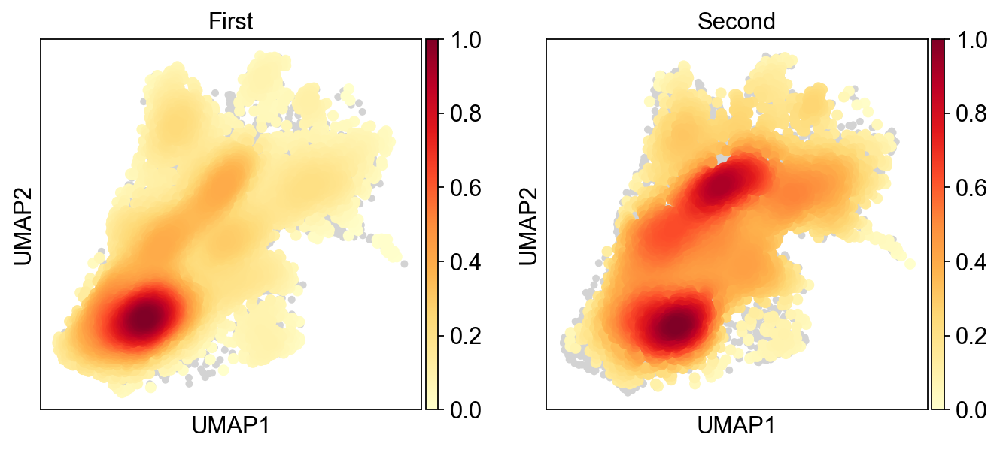

In [26]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_batch_subgroup', )

In [27]:
sc.tl.embedding_density(adata,basis='umap', groupby='clusterK12')

computing density on 'umap'
--> added
    'umap_density_clusterK12', densities (adata.obs)
    'umap_density_clusterK12_params', parameter (adata.uns)


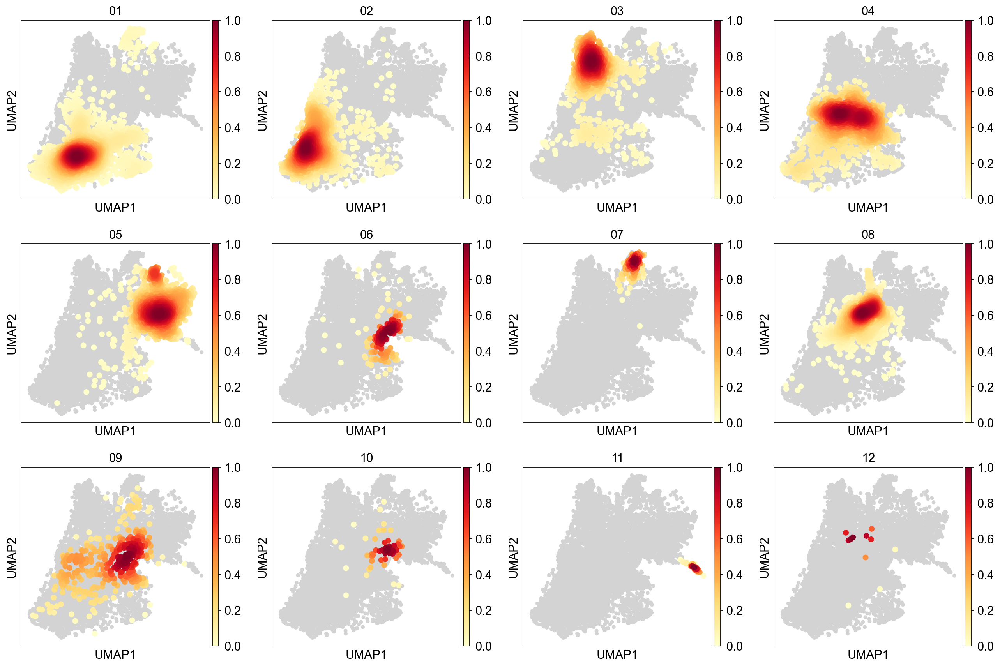

In [28]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_clusterK12')

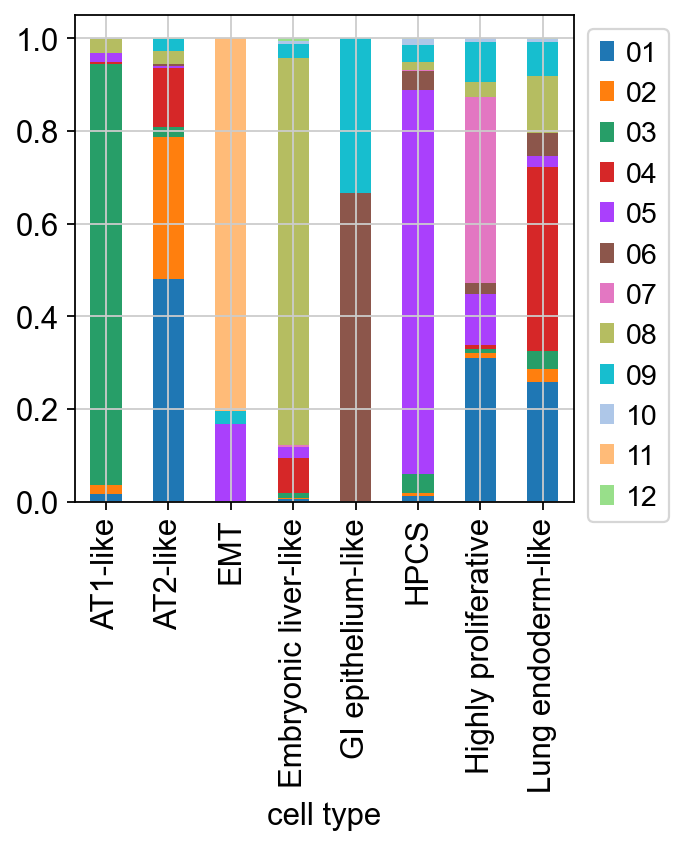

In [29]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['cell type'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Explore Phase

In [30]:
cell_cycle_genes = [x.strip() for x in open('../common_files/regev_lab_cell_cycle_genes_mouse.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [31]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    515 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    472 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


computing PCA
    with n_comps=16


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_pca/__init__.py:379: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm[key_obsm] = X_pca


    finished (0:00:00)


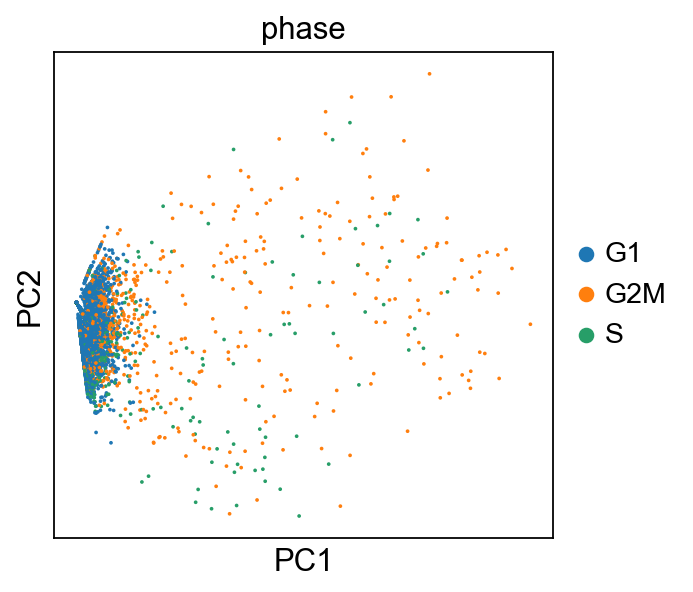

In [32]:
adata_cc_genes = adata[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

## Figures for the paper

In [33]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

lightgray_red = LinearSegmentedColormap.from_list('red_grey', ['lightgray','red'], N=1000)

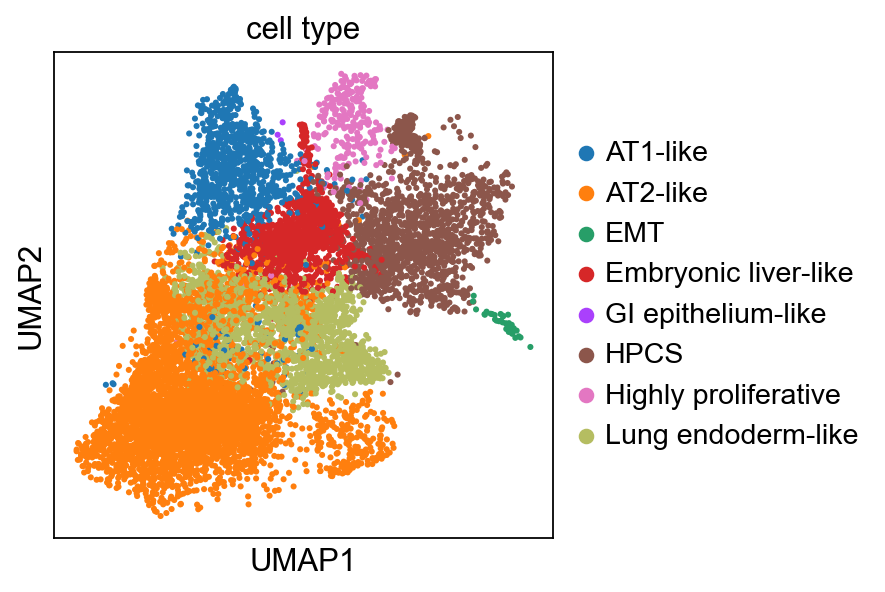

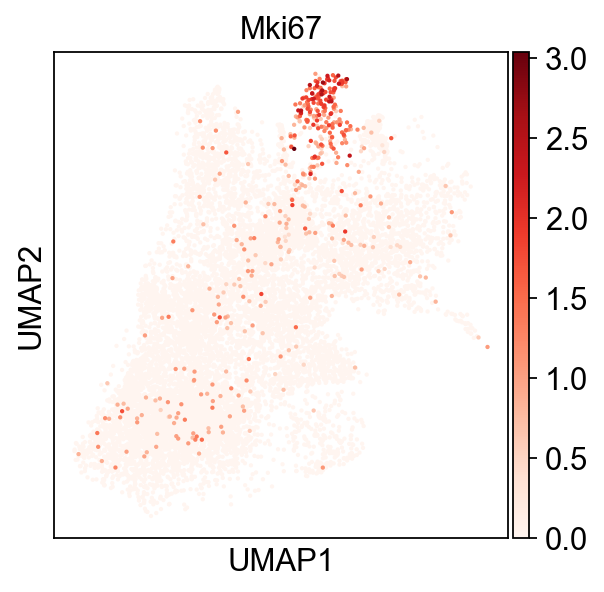

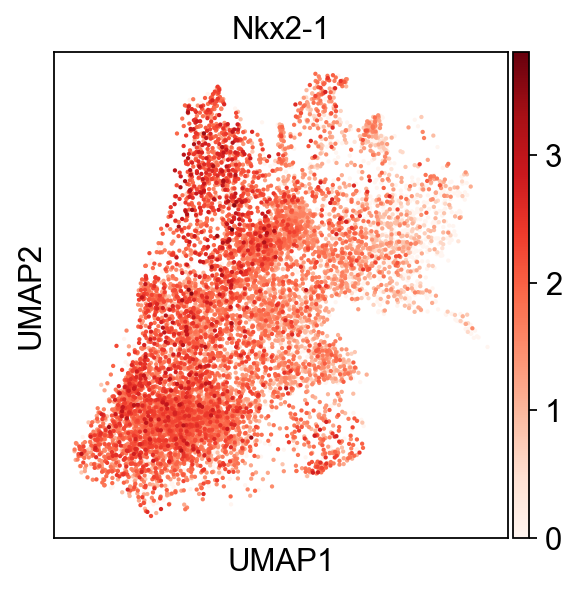

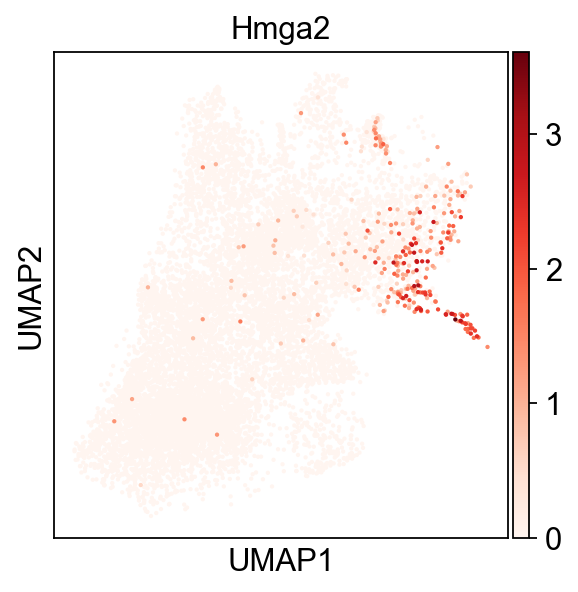

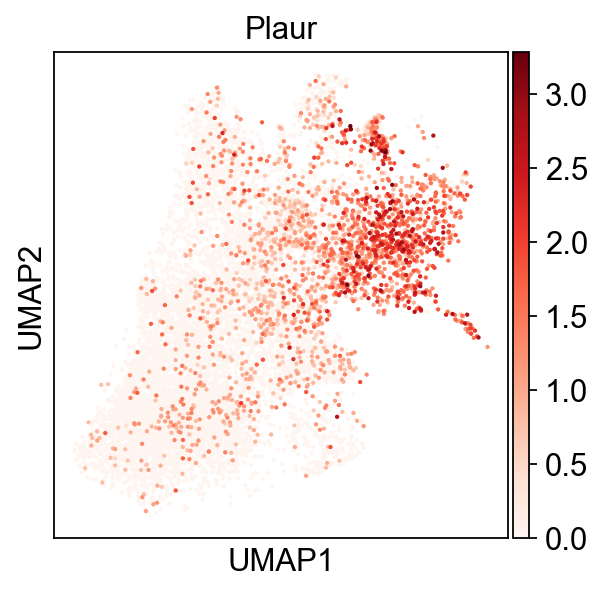

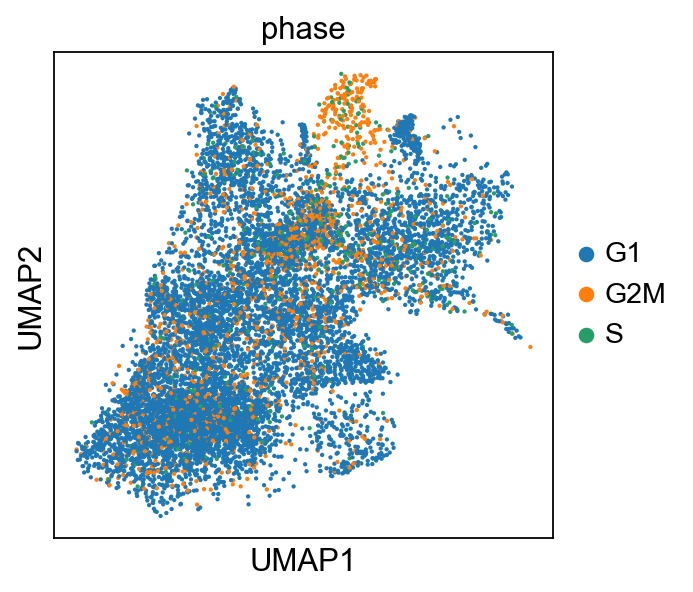

In [34]:
sc.pl.umap(adata, color=['cell type'],save='Fig1a_umap.svg',size=30)
sc.pl.umap(adata, color=['Mki67'],save='Ext_Data_Fig_5g_umap_Mki67.svg',cmap="Reds",size=15)
sc.pl.umap(adata, color=['Nkx2-1'],save='Fig1i_umap_Nkx2-1.svg',cmap="Reds",size=15)
sc.pl.umap(adata, color=['Hmga2'],save='Fig1i_umap_Hmga2.svg',cmap="Reds",size=15)
sc.pl.umap(adata, color=['Plaur'],save='Fig4g_umap_Plaur.svg',cmap="Reds",size=15)
sc.pl.umap(adata, color=['phase'],save='Ext_Data_Fig5g_umap_Phase.svg',size=15)

In [35]:
adata.obs['HPCS_state'] = ['HPCS' if x == 'HPCS' else "other" for x in adata.obs['cell type']]

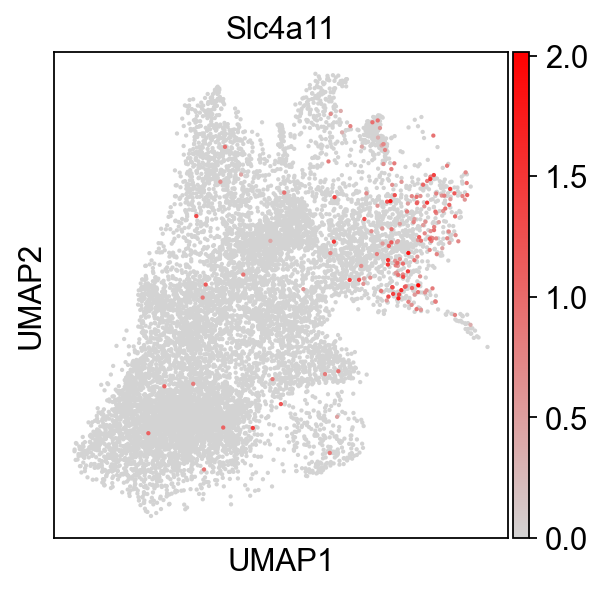

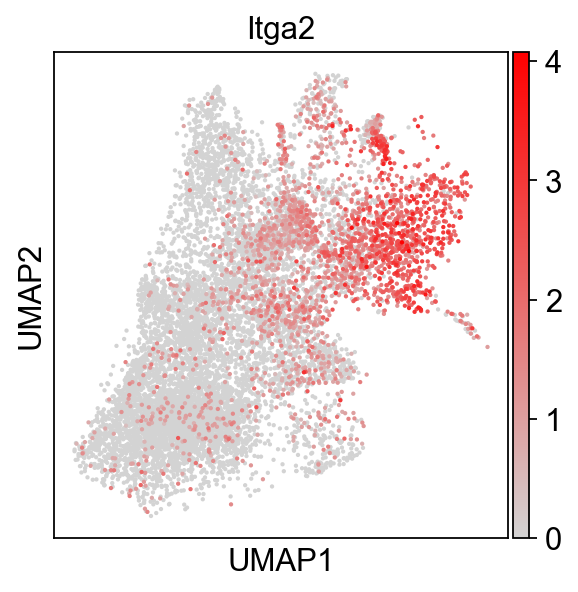

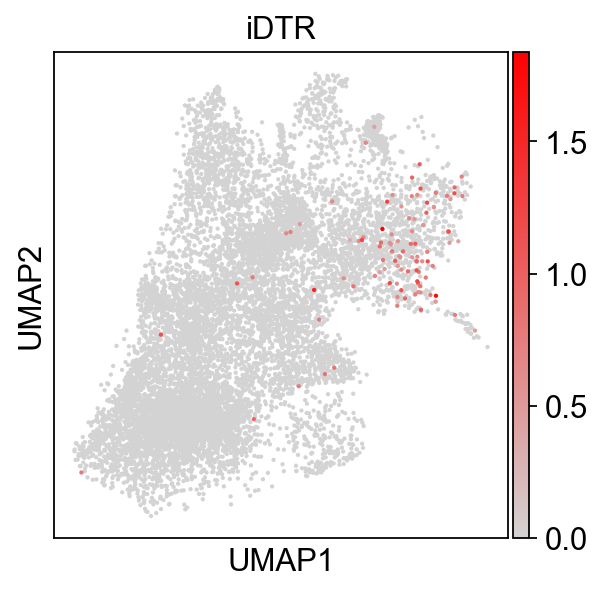

In [36]:
sc.pl.umap(adata, color=['Slc4a11'],save='Ext_Data_Fig4b_umap_Slc4a11.svg',cmap=lightgray_red,size=15)
sc.pl.umap(adata, color=['Itga2'],save='Ext_Data_Fig4b_umap_Itga2.svg',cmap=lightgray_red,size=15)
sc.pl.umap(adata, color=['iDTR'],save='Ext_Data_Fig4b_umap_iDTR.svg',cmap=lightgray_red,size=15)

## For revision - still work in progress as datasets are finalized

### Quantify Slc4a11 expression in Cluster 5 vs other Clusters in single cell data

In [37]:
adata.obs['Slc4a11_obs'] = [1 if x else 0 for x in adata[:,'Slc4a11'].X != adata[:,'Slc4a11'].X.min()]

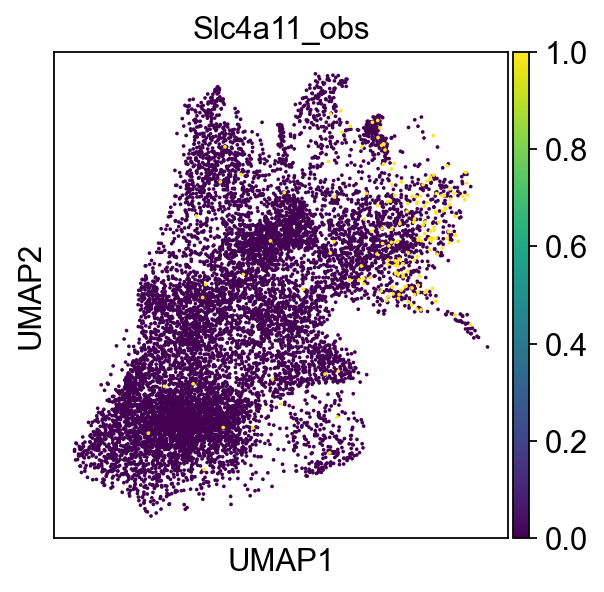

In [38]:
sc.pl.umap(adata, color=['Slc4a11_obs'])

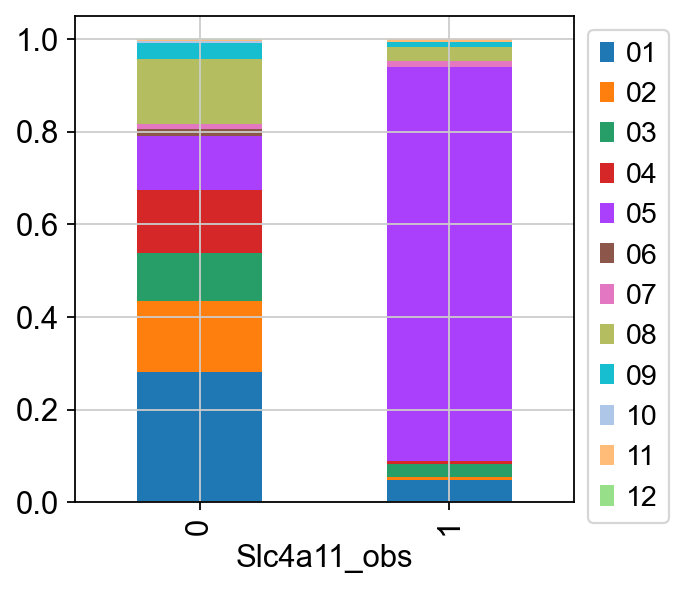

In [39]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Slc4a11_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [40]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x.svg')

In [41]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Slc4a11_obs'], normalize='columns')

Slc4a11_obs,0,1
clusterK12,,
01,0.280321,0.047619
02,0.154601,0.005952
03,0.104294,0.029762
04,0.134214,0.005952
05,0.117225,0.851190
06,0.015573,0.000000
07,0.009722,0.011905
08,0.140727,0.029762
09,0.034828,0.011905


In [42]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Slc4a11_obs'])

Slc4a11_obs,0,1
clusterK12,,
01,2970,8
02,1638,1
03,1105,5
04,1422,1
05,1242,143
06,165,0
07,103,2
08,1491,5
09,369,2


In [43]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_obs'], normalize='columns')

Slc4a11_obs,0,1
cell type,,
AT1-like,0.089099,0.023810
AT2-like,0.476451,0.047619
EMT,0.003115,0.017857
Embryonic liver-like,0.120906,0.023810
GI epithelium-like,0.000283,0.000000
HPCS,0.127702,0.809524
Highly proliferative,0.022652,0.035714
Lung endoderm-like,0.159792,0.041667


In [44]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_obs'])

Slc4a11_obs,0,1
cell type,,
AT1-like,944,4
AT2-like,5048,8
EMT,33,3
Embryonic liver-like,1281,4
GI epithelium-like,3,0
HPCS,1353,136
Highly proliferative,240,6
Lung endoderm-like,1693,7


In [45]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_obs']).sum()

Slc4a11_obs
0    10595
1      168
dtype: int64

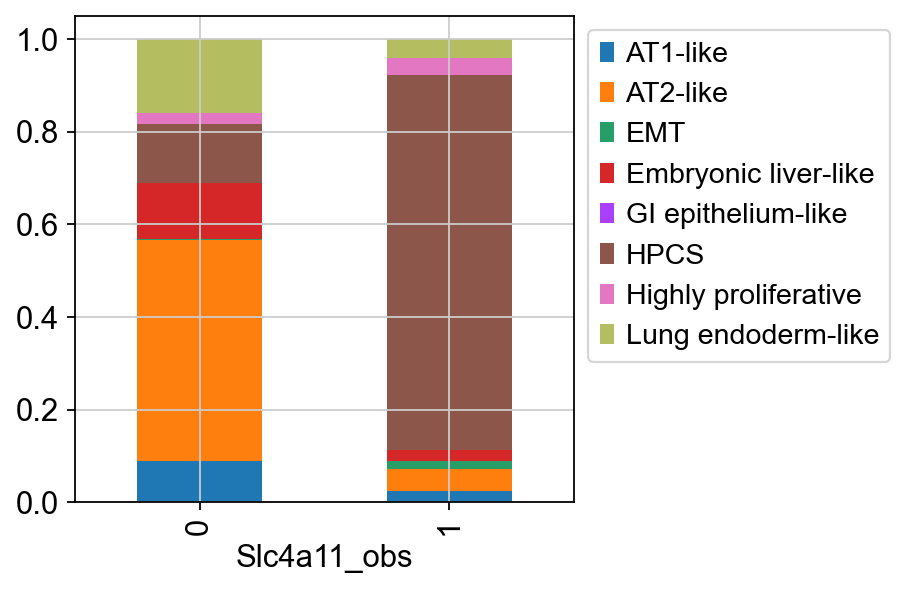

In [46]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [47]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_cell_type.svg')

### Now show by Reporter (iDTR)

In [48]:
adata.obs['iDTR_obs'] = [1 if x else 0 for x in adata[:,'iDTR'].X != adata[:,'iDTR'].X.min()]

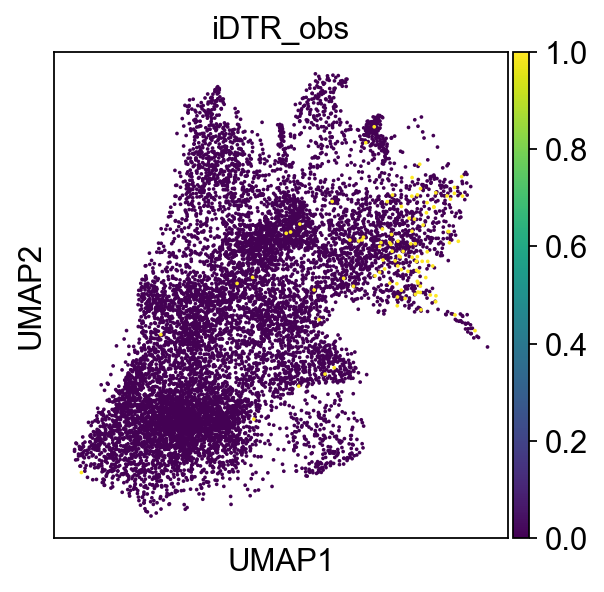

In [49]:
sc.pl.umap(adata, color=['iDTR_obs'])

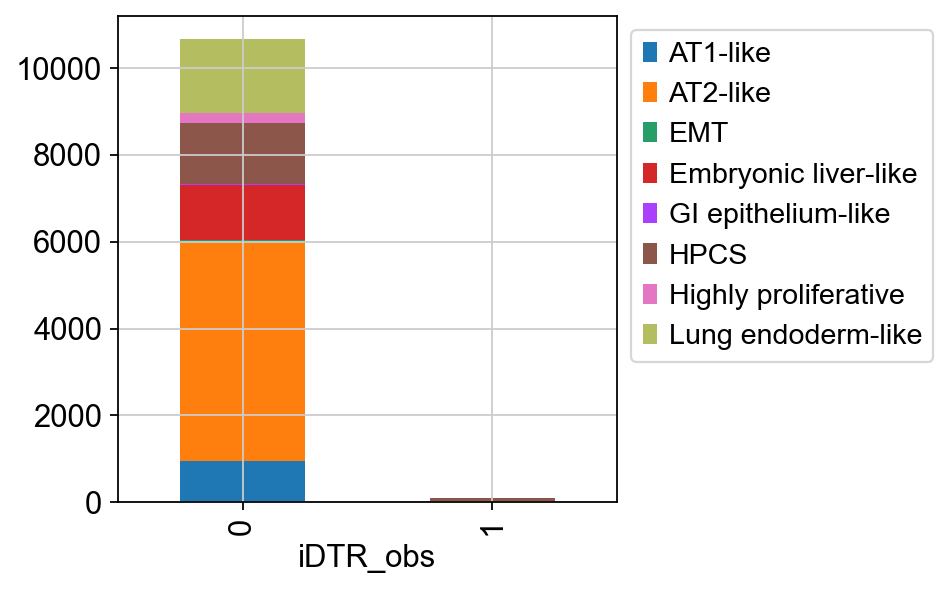

In [50]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs']).T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

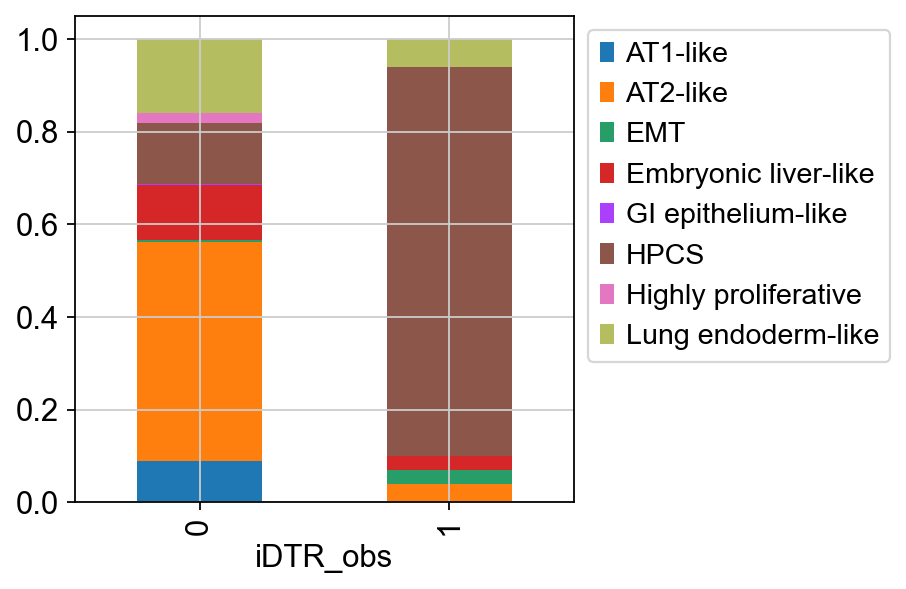

In [51]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [52]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_cell_type_iDTR.svg')

In [53]:
pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs'], normalize='columns')

iDTR_obs,0,1
cell type,,
AT1-like,0.088897,0.000000
AT2-like,0.473743,0.040404
EMT,0.003095,0.030303
Embryonic liver-like,0.120218,0.030303
GI epithelium-like,0.000281,0.000000
HPCS,0.131845,0.838384
Highly proliferative,0.023068,0.000000
Lung endoderm-like,0.158852,0.060606


In [54]:
pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs']).sum()

iDTR_obs
0    10664
1       99
dtype: int64

In [55]:
pd.crosstab(adata.obs['cell type'],adata.obs['iDTR_obs'])

iDTR_obs,0,1
cell type,,
AT1-like,948,0
AT2-like,5052,4
EMT,33,3
Embryonic liver-like,1282,3
GI epithelium-like,3,0
HPCS,1406,83
Highly proliferative,246,0
Lung endoderm-like,1694,6


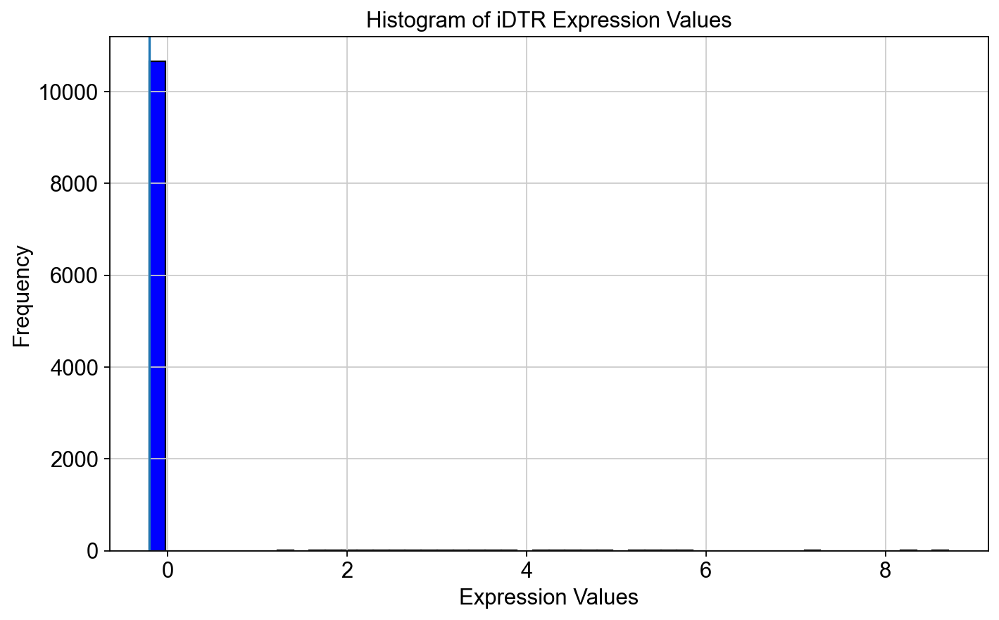

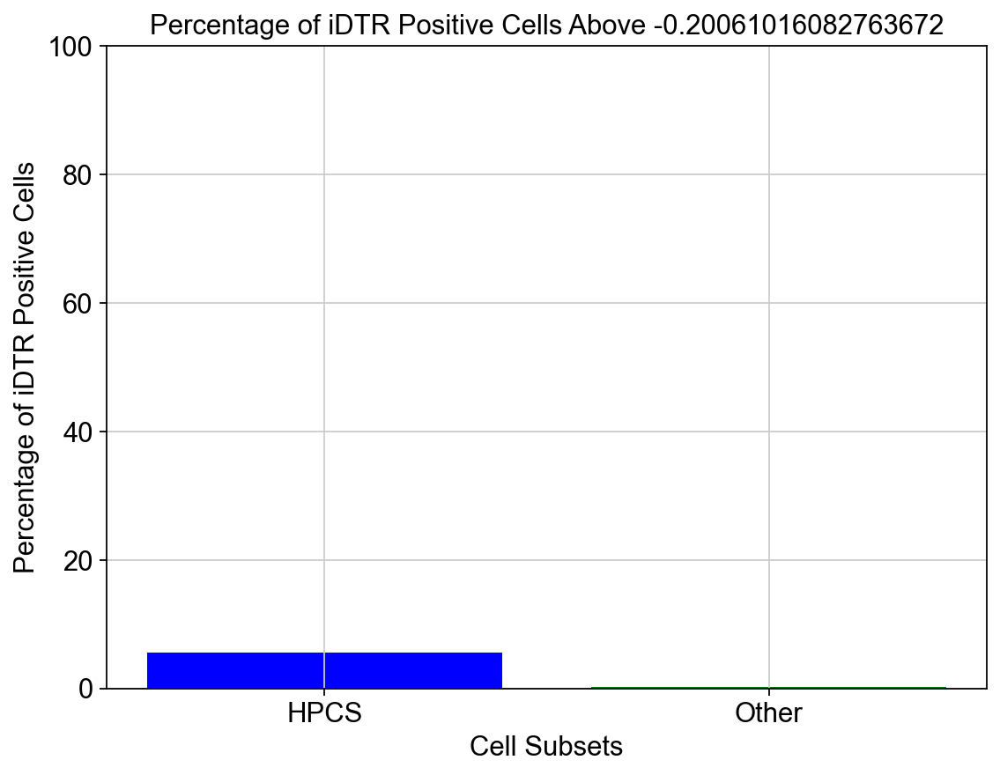

SignificanceResult(statistic=34.157805832147936, pvalue=8.1366253284191325e-56)

In [56]:
gene = 'iDTR'
expression_values = adata[:, gene].X
threshold = adata[:,'iDTR'].X.min()
#threshold = 1

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata[adata.obs['cell type'] == 'HPCS',:]
subset_b = adata[adata.obs['cell type'] != 'HPCS',:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Revision_1_{gene}_positive_cells_percentage_10x_cell_type_iDTR.svg')
plt.show()

# calculate statistics
from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

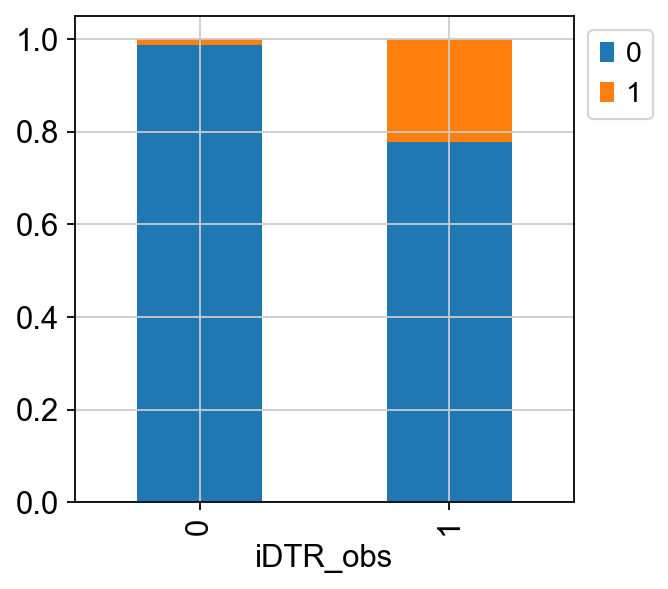

In [57]:
 cell_proportion_df = pd.crosstab(adata.obs['Slc4a11_obs'],adata.obs['iDTR_obs'], normalize='columns').T.plot(kind='bar', stacked=True,).legend(bbox_to_anchor=(1,1))

In [58]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Slc4a11_iDTR.svg')

In [59]:
pd.crosstab(adata.obs['Slc4a11_obs'],adata.obs['iDTR_obs']).sum()

iDTR_obs
0    10664
1       99
dtype: int64

In [60]:
pd.crosstab(adata.obs['Slc4a11_obs'],adata.obs['iDTR_obs'])

iDTR_obs,0,1
Slc4a11_obs,,
0,10518,77
1,146,22


### Now combine Slc4a11 and Reporter (iDTR)

In [61]:
np.logical_or(adata[:,'iDTR'].X != adata[:,'iDTR'].X.min(), adata[:,'Slc4a11'].X != adata[:,'Slc4a11'].X.min())

array([[False],
       [ True],
       [False],
       ...,
       [False],
       [False],
       [False]])

In [62]:
adata.obs['Slc4a11_iDTR_obs'] = [1 if x else 0 for x in np.logical_or(adata[:,'iDTR'].X != adata[:,'iDTR'].X.min(), adata[:,'Slc4a11'].X != adata[:,'Slc4a11'].X.min())]

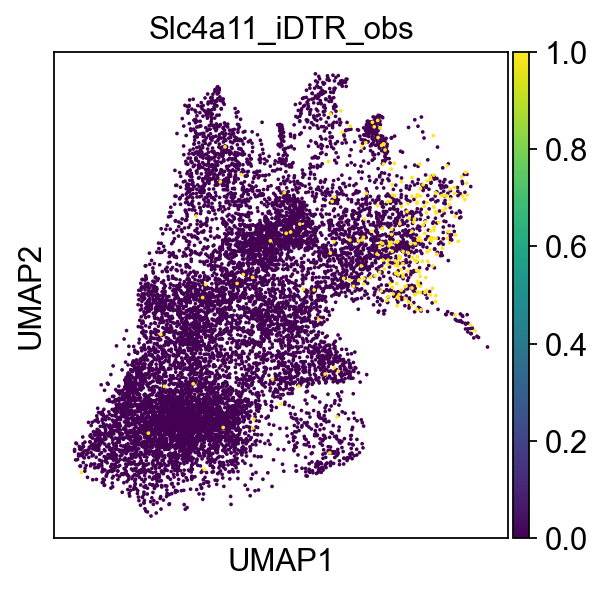

In [63]:
sc.pl.umap(adata, color=['Slc4a11_iDTR_obs'])

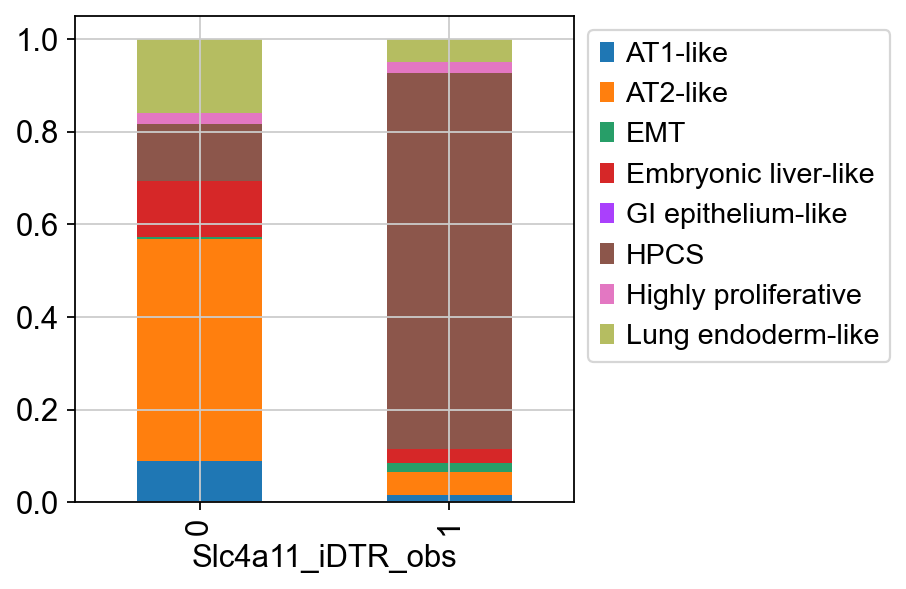

In [64]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_iDTR_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [65]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_cell_type_Slc4a11_iDTR.svg')

In [66]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_iDTR_obs'], normalize='columns')

Slc4a11_iDTR_obs,0,1
cell type,,
AT1-like,0.089751,0.016327
AT2-like,0.479559,0.048980
EMT,0.002947,0.020408
Embryonic liver-like,0.121506,0.028571
GI epithelium-like,0.000285,0.000000
HPCS,0.122647,0.812245
Highly proliferative,0.022818,0.024490
Lung endoderm-like,0.160487,0.048980


In [67]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_iDTR_obs']).sum()

Slc4a11_iDTR_obs
0    10518
1      245
dtype: int64

In [68]:
pd.crosstab(adata.obs['cell type'],adata.obs['Slc4a11_iDTR_obs'])

Slc4a11_iDTR_obs,0,1
cell type,,
AT1-like,944,4
AT2-like,5044,12
EMT,31,5
Embryonic liver-like,1278,7
GI epithelium-like,3,0
HPCS,1290,199
Highly proliferative,240,6
Lung endoderm-like,1688,12


In [69]:
pd.crosstab(adata.obs['Slc4a11_obs'],adata.obs['iDTR_obs']).sum()

iDTR_obs
0    10664
1       99
dtype: int64

In [70]:
pd.crosstab(adata.obs['Slc4a11_obs'],adata.obs['iDTR_obs'])

iDTR_obs,0,1
Slc4a11_obs,,
0,10518,77
1,146,22


### Quantify Hopx expression in AT1-like vs other Clusters in single cell data

In [71]:
adata.obs['Hopx_obs'] = [1 if x else 0 for x in adata[:,'Hopx'].X != adata[:,'Hopx'].X.min()]

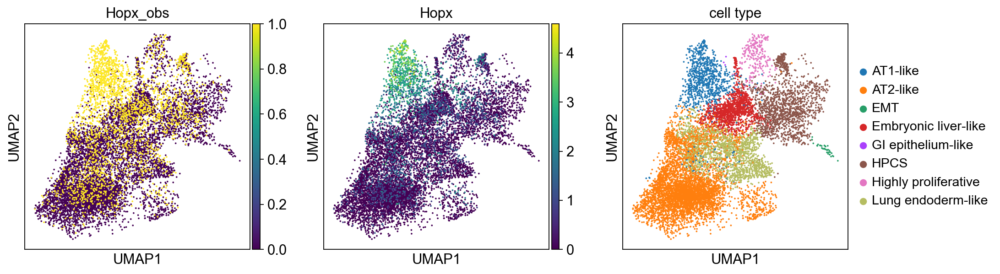

In [72]:
sc.pl.umap(adata, color=['Hopx_obs', 'Hopx','cell type'])

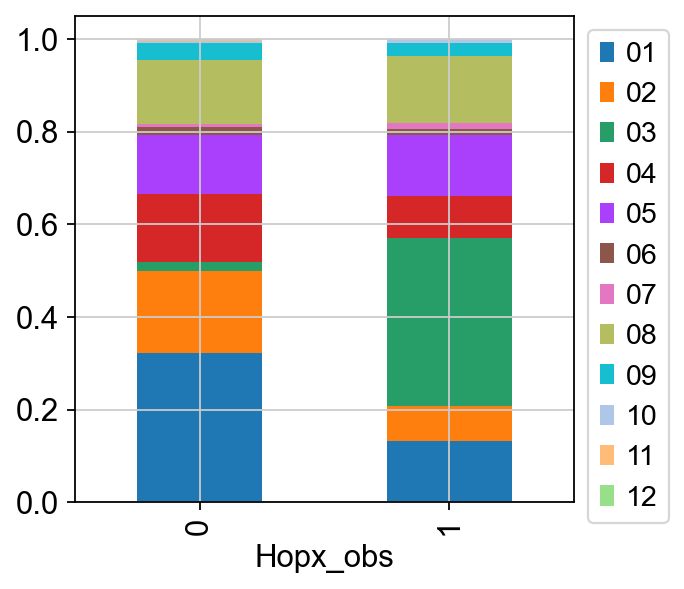

In [73]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Hopx_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [74]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Hopx_10x.svg')

In [75]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Hopx_obs'], normalize='columns')

Hopx_obs,0,1
clusterK12,,
01,0.323211,0.132750
02,0.176912,0.076075
03,0.019302,0.362495
04,0.146177,0.089007
05,0.127121,0.133511
06,0.016597,0.011411
07,0.008237,0.014454
08,0.137202,0.144542
09,0.036636,0.027767


In [76]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Hopx_obs'])

Hopx_obs,0,1
clusterK12,,
01,2629,349
02,1439,200
03,157,953
04,1189,234
05,1034,351
06,135,30
07,67,38
08,1116,380
09,298,73


In [77]:
pd.crosstab(adata.obs['cell type'],adata.obs['Hopx_obs'], normalize='columns')

Hopx_obs,0,1
cell type,,
AT1-like,0.010942,0.326740
AT2-like,0.546840,0.231267
EMT,0.004180,0.000761
Embryonic liver-like,0.117777,0.124382
GI epithelium-like,0.000246,0.000380
HPCS,0.132776,0.155572
Highly proliferative,0.021269,0.027767
Lung endoderm-like,0.165970,0.133130


In [78]:
pd.crosstab(adata.obs['cell type'],adata.obs['Hopx_obs'])

Hopx_obs,0,1
cell type,,
AT1-like,89,859
AT2-like,4448,608
EMT,34,2
Embryonic liver-like,958,327
GI epithelium-like,2,1
HPCS,1080,409
Highly proliferative,173,73
Lung endoderm-like,1350,350


In [79]:
pd.crosstab(adata.obs['cell type'],adata.obs['Hopx_obs']).sum()

Hopx_obs
0    8134
1    2629
dtype: int64

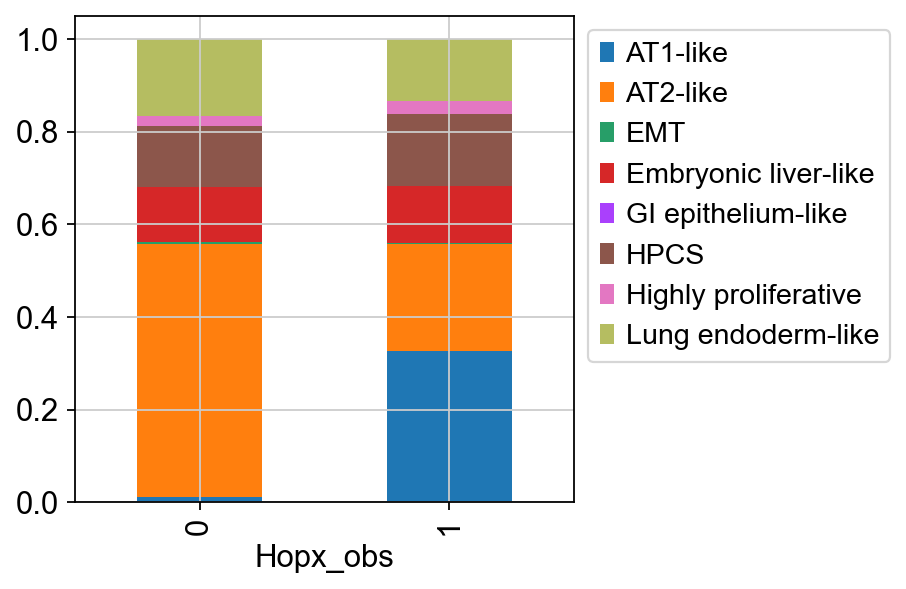

In [80]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Hopx_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [81]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Hopx_cell_type.svg')

### Quantify Stmn2 expression in EMT vs other Clusters in single cell data

In [82]:
adata.obs['Stmn2_obs'] = [1 if x else 0 for x in adata[:,'Stmn2'].X != adata[:,'Stmn2'].X.min()]

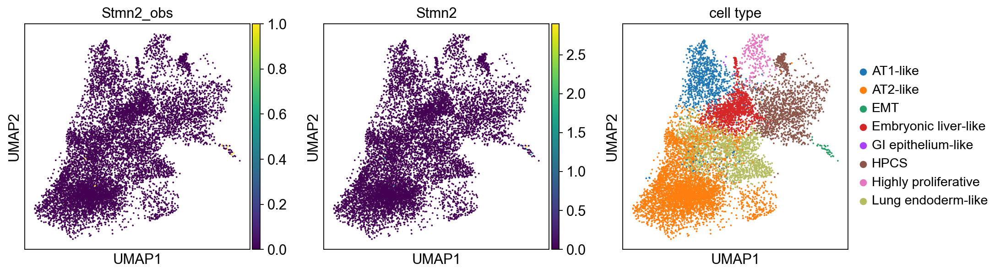

In [83]:
sc.pl.umap(adata, color=['Stmn2_obs', 'Stmn2','cell type'])

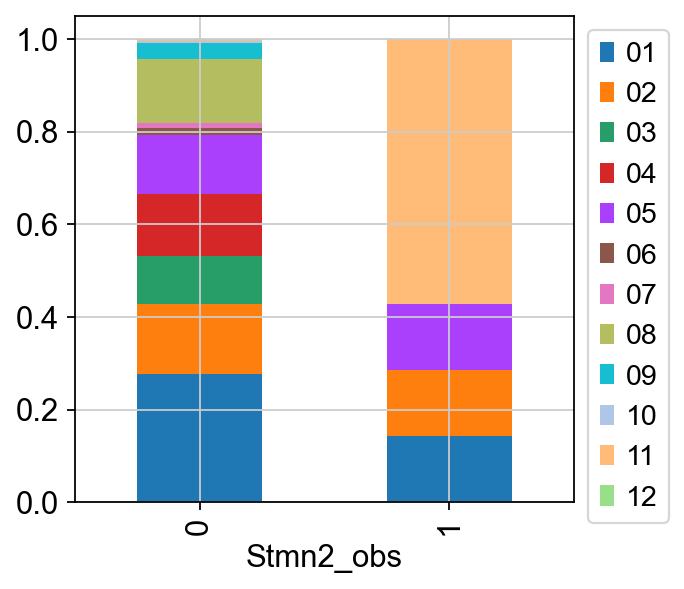

In [84]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Stmn2_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [85]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Stmn2_10x.svg')

In [86]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Stmn2_obs'], normalize='columns')

Stmn2_obs,0,1
clusterK12,,
01,0.276776,0.142857
02,0.152287,0.142857
03,0.103198,0.000000
04,0.132298,0.000000
05,0.128672,0.142857
06,0.015340,0.000000
07,0.009762,0.000000
08,0.139085,0.000000
09,0.034492,0.000000


In [87]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Stmn2_obs'])

Stmn2_obs,0,1
clusterK12,,
01,2977,1
02,1638,1
03,1110,0
04,1423,0
05,1384,1
06,165,0
07,105,0
08,1496,0
09,371,0


In [88]:
pd.crosstab(adata.obs['cell type'],adata.obs['Stmn2_obs'], normalize='columns')

Stmn2_obs,0,1
cell type,,
AT1-like,0.088137,0.000000
AT2-like,0.469877,0.285714
EMT,0.002882,0.714286
Embryonic liver-like,0.119468,0.000000
GI epithelium-like,0.000279,0.000000
HPCS,0.138434,0.000000
Highly proliferative,0.022871,0.000000
Lung endoderm-like,0.158051,0.000000


In [89]:
pd.crosstab(adata.obs['cell type'],adata.obs['Stmn2_obs'])

Stmn2_obs,0,1
cell type,,
AT1-like,948,0
AT2-like,5054,2
EMT,31,5
Embryonic liver-like,1285,0
GI epithelium-like,3,0
HPCS,1489,0
Highly proliferative,246,0
Lung endoderm-like,1700,0


In [90]:
pd.crosstab(adata.obs['cell type'],adata.obs['Stmn2_obs']).sum()

Stmn2_obs
0    10756
1        7
dtype: int64

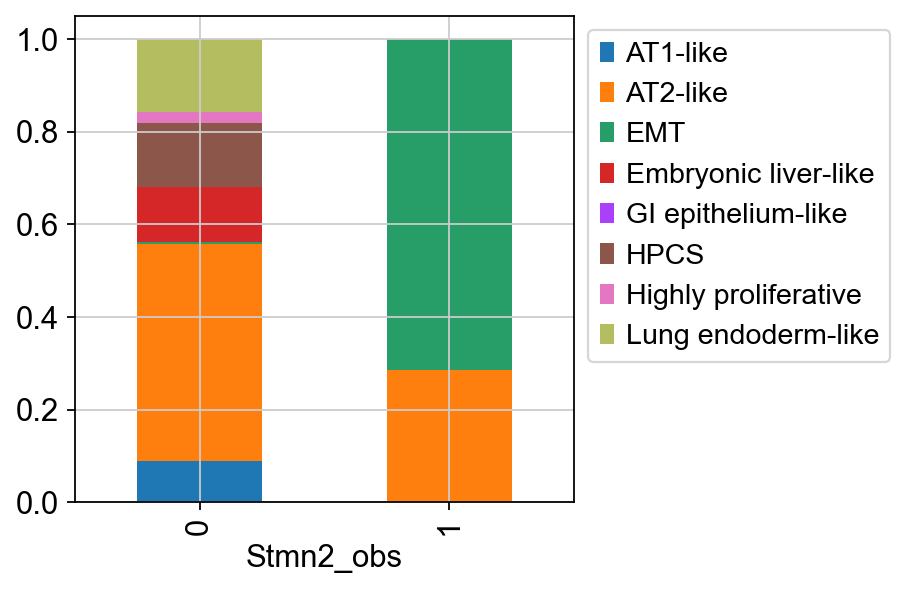

In [91]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Stmn2_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [92]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Stmn2_cell_type.svg')

### Quantify Prtg expression in Embryonic liver-like vs other Clusters in single cell data

In [93]:
adata.obs['Prtg_obs'] = [1 if x else 0 for x in adata[:,'Prtg'].X != adata[:,'Prtg'].X.min()]

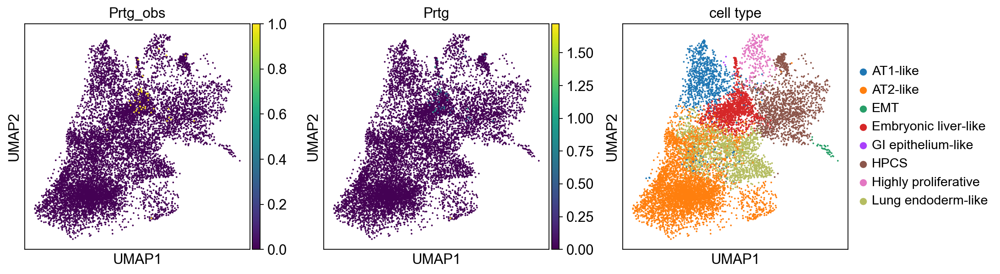

In [94]:
sc.pl.umap(adata, color=['Prtg_obs', 'Prtg','cell type'])

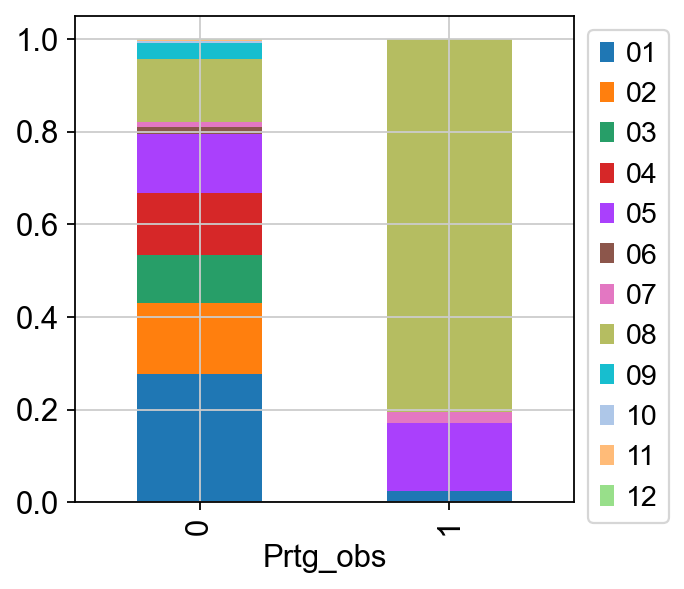

In [95]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Prtg_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [96]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Prtg_10x.svg')

In [97]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Prtg_obs'], normalize='columns')

Prtg_obs,0,1
clusterK12,,
01,0.277653,0.024390
02,0.152863,0.000000
03,0.103525,0.000000
04,0.132718,0.000000
05,0.128614,0.146341
06,0.015389,0.000000
07,0.009700,0.024390
08,0.136448,0.804878
09,0.034602,0.000000


In [98]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Prtg_obs'])

Prtg_obs,0,1
clusterK12,,
01,2977,1
02,1639,0
03,1110,0
04,1423,0
05,1379,6
06,165,0
07,104,1
08,1463,33
09,371,0


In [99]:
pd.crosstab(adata.obs['cell type'],adata.obs['Prtg_obs'], normalize='columns')

Prtg_obs,0,1
cell type,,
AT1-like,0.088416,0.000000
AT2-like,0.471461,0.024390
EMT,0.003358,0.000000
Embryonic liver-like,0.116863,0.780488
GI epithelium-like,0.000280,0.000000
HPCS,0.138407,0.121951
Highly proliferative,0.022757,0.048780
Lung endoderm-like,0.158459,0.024390


In [100]:
pd.crosstab(adata.obs['cell type'],adata.obs['Prtg_obs'])

Prtg_obs,0,1
cell type,,
AT1-like,948,0
AT2-like,5055,1
EMT,36,0
Embryonic liver-like,1253,32
GI epithelium-like,3,0
HPCS,1484,5
Highly proliferative,244,2
Lung endoderm-like,1699,1


In [101]:
pd.crosstab(adata.obs['cell type'],adata.obs['Prtg_obs']).sum()

Prtg_obs
0    10722
1       41
dtype: int64

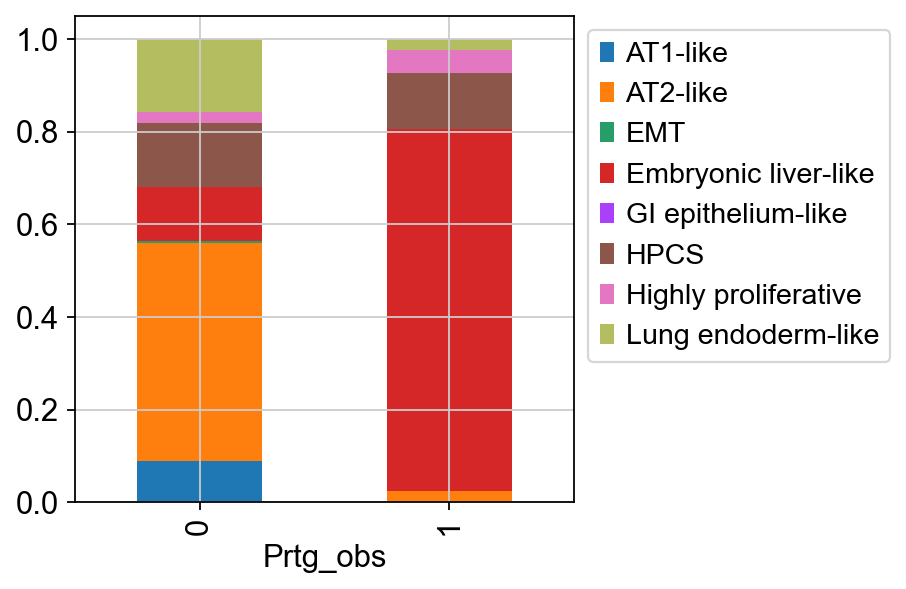

In [102]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Prtg_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [103]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Prtg_cell_type.svg')

### Quantify Cd177 expression in Lung endoderm-like vs other Clusters in single cell data

In [104]:
adata.obs['Cd177_obs'] = [1 if x else 0 for x in adata[:,'Cd177'].X != adata[:,'Cd177'].X.min()]

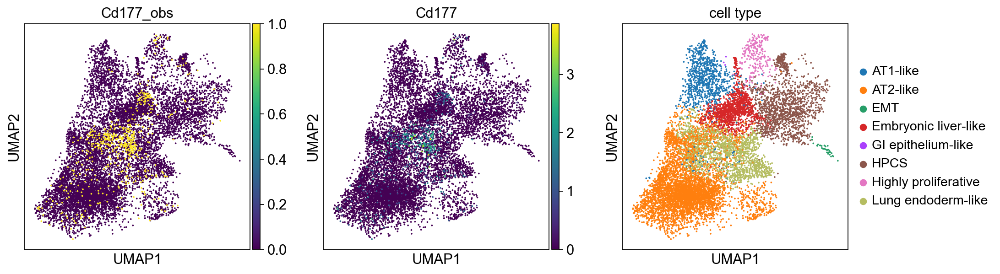

In [105]:
sc.pl.umap(adata, color=['Cd177_obs', 'Cd177','cell type'])

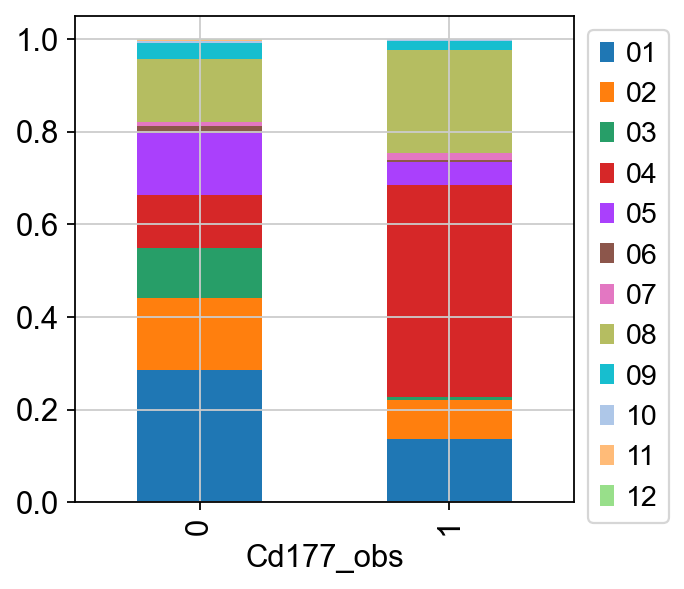

In [106]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Cd177_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [107]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Cd177_10x.svg')

In [108]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Cd177_obs'], normalize='columns')

Cd177_obs,0,1
clusterK12,,
01,0.284565,0.136364
02,0.156118,0.083916
03,0.108527,0.006993
04,0.113924,0.458042
05,0.133157,0.048951
06,0.015896,0.005245
07,0.009518,0.013986
08,0.134334,0.222028
09,0.035227,0.020979


In [109]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Cd177_obs'])

Cd177_obs,0,1
clusterK12,,
01,2900,78
02,1591,48
03,1106,4
04,1161,262
05,1357,28
06,162,3
07,97,8
08,1369,127
09,359,12


In [110]:
pd.crosstab(adata.obs['cell type'],adata.obs['Cd177_obs'], normalize='columns')

Cd177_obs,0,1
cell type,,
AT1-like,0.092827,0.003497
AT2-like,0.473261,0.407343
EMT,0.003533,0.000000
Embryonic liver-like,0.118045,0.143357
GI epithelium-like,0.000294,0.000000
HPCS,0.143656,0.043706
Highly proliferative,0.022078,0.036713
Lung endoderm-like,0.146306,0.365385


In [111]:
pd.crosstab(adata.obs['cell type'],adata.obs['Cd177_obs'])

Cd177_obs,0,1
cell type,,
AT1-like,946,2
AT2-like,4823,233
EMT,36,0
Embryonic liver-like,1203,82
GI epithelium-like,3,0
HPCS,1464,25
Highly proliferative,225,21
Lung endoderm-like,1491,209


In [112]:
pd.crosstab(adata.obs['cell type'],adata.obs['Cd177_obs']).sum()

Cd177_obs
0    10191
1      572
dtype: int64

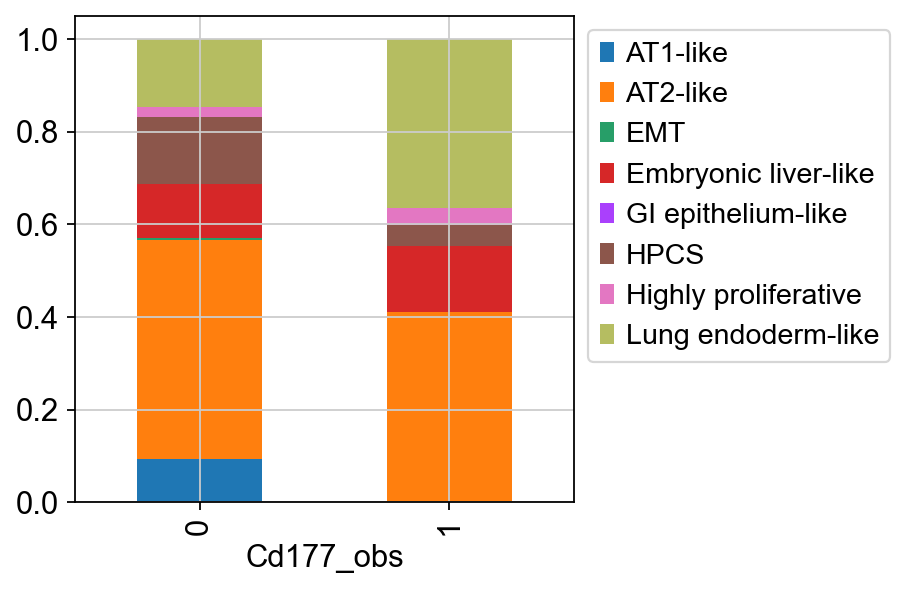

In [113]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Cd177_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [114]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Cd177_cell_type.svg')

### Quantify Map6 expression in AT1-like vs other Clusters in single cell data

In [115]:
adata.obs['Map6_obs'] = [1 if x else 0 for x in adata[:,'Map6'].X != adata[:,'Map6'].X.min()]

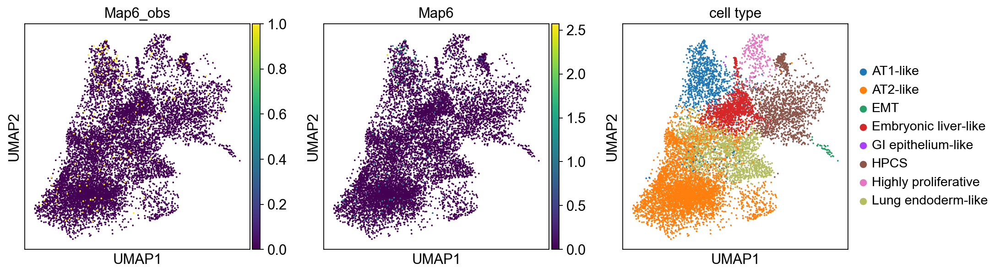

In [116]:
sc.pl.umap(adata, color=['Map6_obs', 'Map6','cell type'])

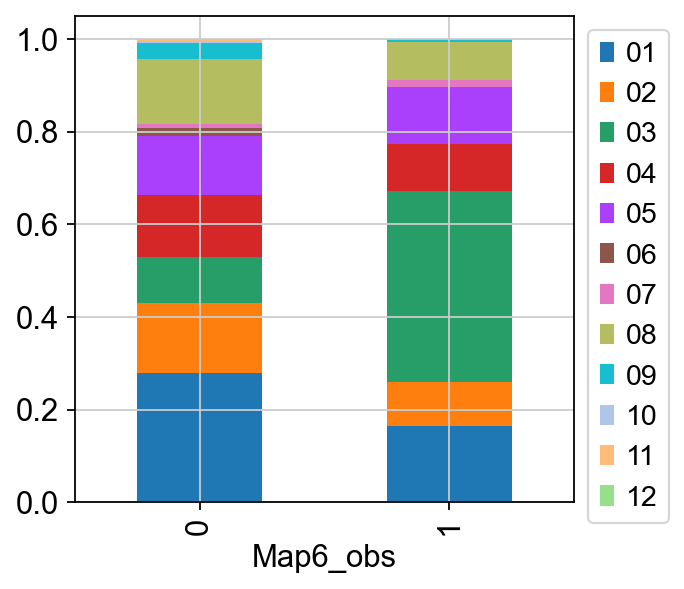

In [117]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Map6_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [118]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Map6_10x.svg')

In [119]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Map6_obs'], normalize='columns')

Map6_obs,0,1
clusterK12,,
01,0.278233,0.164384
02,0.153056,0.095890
03,0.098898,0.410959
04,0.132618,0.102740
05,0.128756,0.123288
06,0.015541,0.000000
07,0.009701,0.013699
08,0.139776,0.082192
09,0.034850,0.006849


In [120]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Map6_obs'])

Map6_obs,0,1
clusterK12,,
01,2954,24
02,1625,14
03,1050,60
04,1408,15
05,1367,18
06,165,0
07,103,2
08,1484,12
09,370,1


In [121]:
pd.crosstab(adata.obs['cell type'],adata.obs['Map6_obs'], normalize='columns')

Map6_obs,0,1
cell type,,
AT1-like,0.084205,0.369863
AT2-like,0.471508,0.342466
EMT,0.003391,0.000000
Embryonic liver-like,0.120185,0.061644
GI epithelium-like,0.000283,0.000000
HPCS,0.138551,0.123288
Highly proliferative,0.022794,0.027397
Lung endoderm-like,0.159084,0.075342


In [122]:
pd.crosstab(adata.obs['cell type'],adata.obs['Map6_obs'])

Map6_obs,0,1
cell type,,
AT1-like,894,54
AT2-like,5006,50
EMT,36,0
Embryonic liver-like,1276,9
GI epithelium-like,3,0
HPCS,1471,18
Highly proliferative,242,4
Lung endoderm-like,1689,11


In [123]:
pd.crosstab(adata.obs['cell type'],adata.obs['Map6_obs']).sum()

Map6_obs
0    10617
1      146
dtype: int64

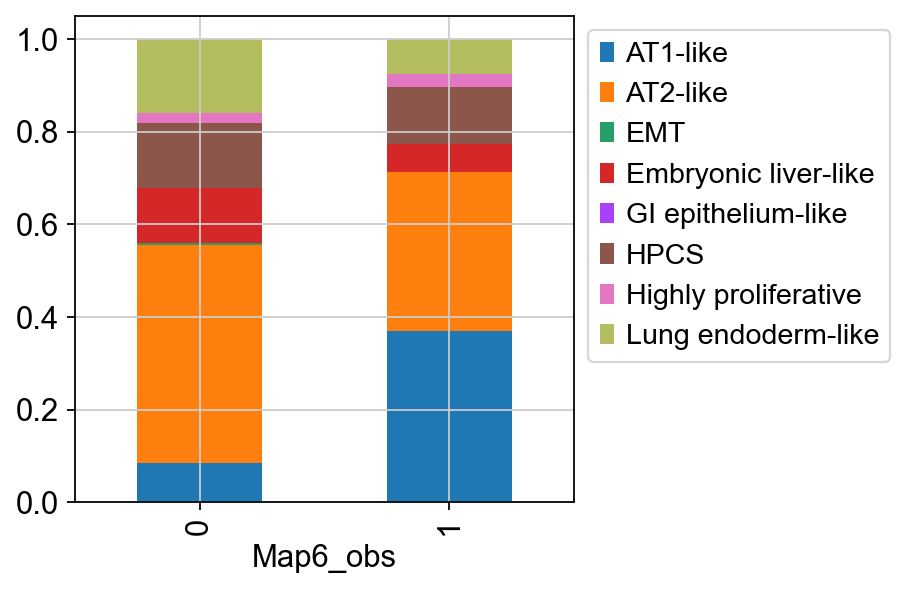

In [124]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Map6_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [125]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Map6_cell_type.svg')

### Quantify Il23a expression in HPCS vs other Clusters in single cell data

In [126]:
adata.obs['Il23a_obs'] = [1 if x else 0 for x in adata[:,'Il23a'].X != adata[:,'Il23a'].X.min()]

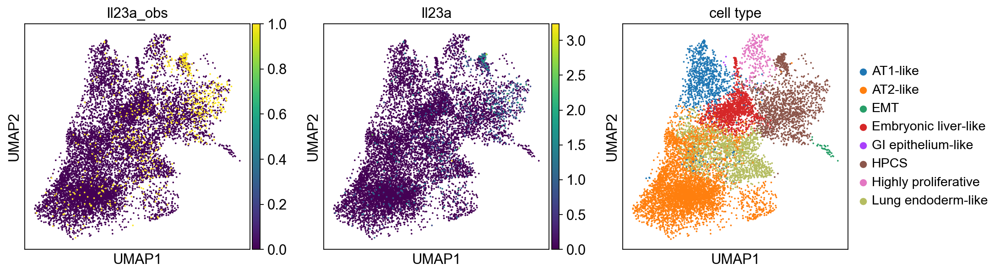

In [127]:
sc.pl.umap(adata, color=['Il23a_obs', 'Il23a','cell type'])

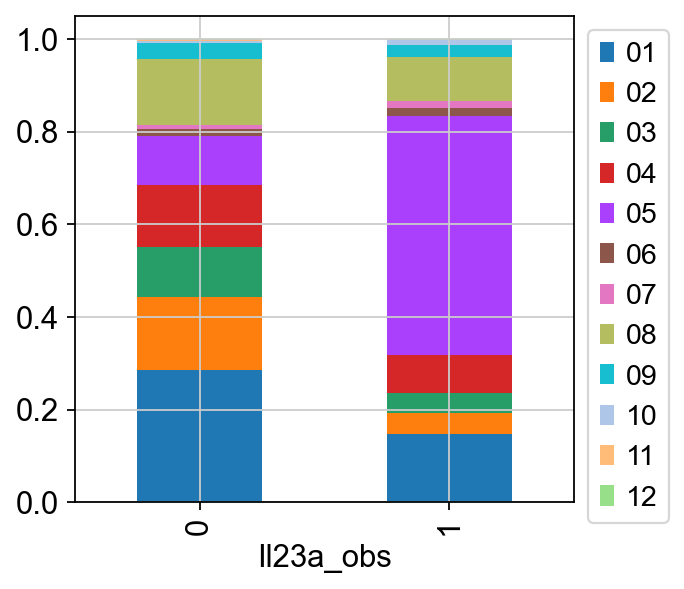

In [128]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Il23a_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [129]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Il23a_10x.svg')

In [130]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Il23a_obs'], normalize='columns')

Il23a_obs,0,1
clusterK12,,
01,0.284685,0.147854
02,0.158970,0.044515
03,0.106868,0.042925
04,0.135287,0.082671
05,0.104598,0.516693
06,0.015295,0.015898
07,0.009374,0.015898
08,0.141701,0.095390
09,0.035031,0.025437


In [131]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Il23a_obs'])

Il23a_obs,0,1
clusterK12,,
01,2885,93
02,1611,28
03,1083,27
04,1371,52
05,1060,325
06,155,10
07,95,10
08,1436,60
09,355,16


In [132]:
pd.crosstab(adata.obs['cell type'],adata.obs['Il23a_obs'], normalize='columns')

Il23a_obs,0,1
cell type,,
AT1-like,0.091376,0.034976
AT2-like,0.486679,0.197138
EMT,0.003454,0.001590
Embryonic liver-like,0.121966,0.077901
GI epithelium-like,0.000296,0.000000
HPCS,0.116440,0.491256
Highly proliferative,0.021018,0.052464
Lung endoderm-like,0.158772,0.144674


In [133]:
pd.crosstab(adata.obs['cell type'],adata.obs['Il23a_obs'])

Il23a_obs,0,1
cell type,,
AT1-like,926,22
AT2-like,4932,124
EMT,35,1
Embryonic liver-like,1236,49
GI epithelium-like,3,0
HPCS,1180,309
Highly proliferative,213,33
Lung endoderm-like,1609,91


In [134]:
pd.crosstab(adata.obs['cell type'],adata.obs['Il23a_obs']).sum()

Il23a_obs
0    10134
1      629
dtype: int64

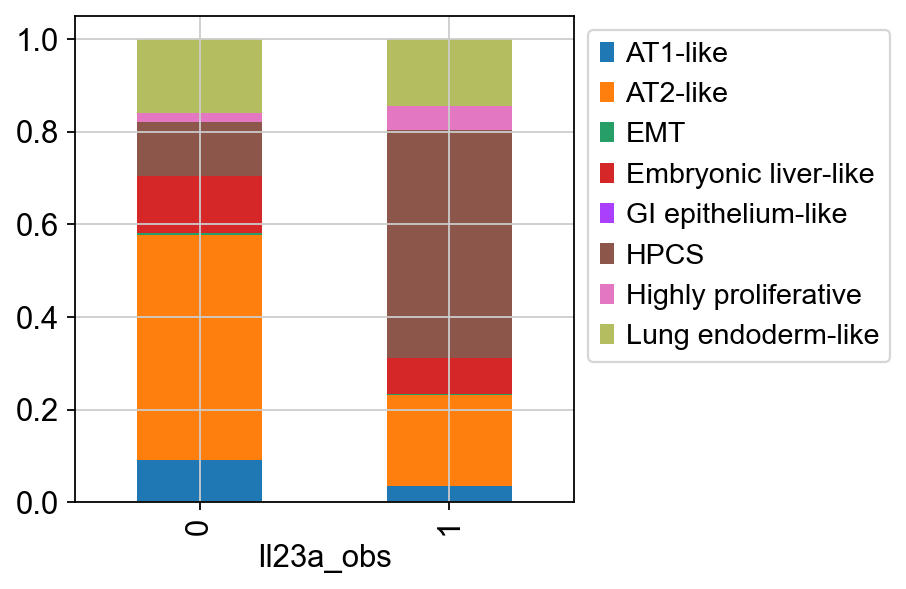

In [135]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Il23a_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [136]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Il23a_cell_type.svg')

### Quantify Rrad expression in HPCS vs other Clusters in single cell data

In [137]:
adata.obs['Rrad_obs'] = [1 if x else 0 for x in adata[:,'Rrad'].X != adata[:,'Rrad'].X.min()]

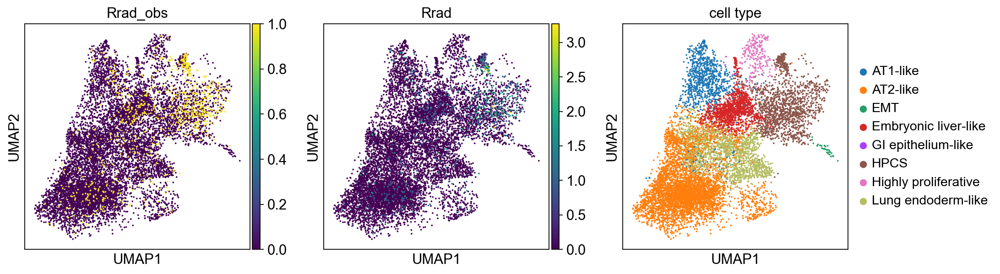

In [138]:
sc.pl.umap(adata, color=['Rrad_obs', 'Rrad','cell type'])

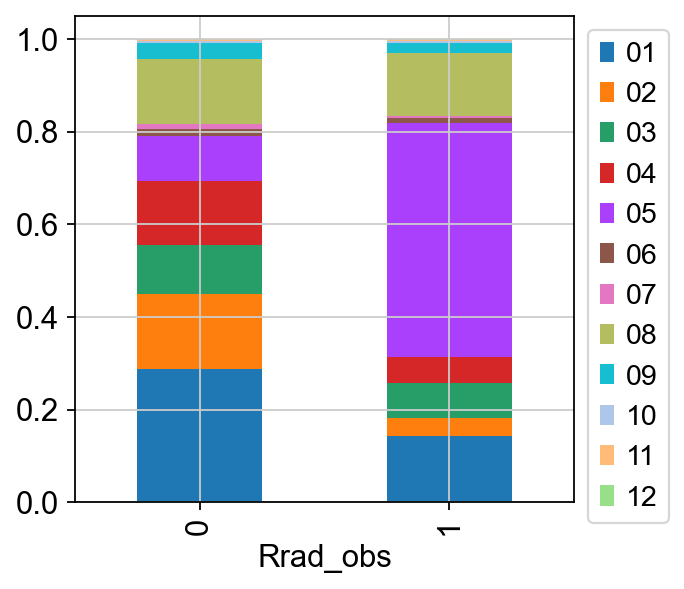

In [139]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Rrad_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [140]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Rrad_10x.svg')

In [141]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Rrad_obs'], normalize='columns')

Rrad_obs,0,1
clusterK12,,
01,0.287740,0.142683
02,0.161521,0.040244
03,0.105501,0.074390
04,0.138389,0.057317
05,0.097757,0.503659
06,0.015689,0.010976
07,0.010158,0.004878
08,0.139193,0.136585
09,0.035603,0.020732


In [142]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Rrad_obs'])

Rrad_obs,0,1
clusterK12,,
01,2861,117
02,1606,33
03,1049,61
04,1376,47
05,972,413
06,156,9
07,101,4
08,1384,112
09,354,17


In [143]:
pd.crosstab(adata.obs['cell type'],adata.obs['Rrad_obs'], normalize='columns')

Rrad_obs,0,1
cell type,,
AT1-like,0.089611,0.069512
AT2-like,0.492708,0.191463
EMT,0.003419,0.002439
Embryonic liver-like,0.118475,0.130488
GI epithelium-like,0.000302,0.000000
HPCS,0.109424,0.489024
Highly proliferative,0.021925,0.034146
Lung endoderm-like,0.164136,0.082927


In [144]:
pd.crosstab(adata.obs['cell type'],adata.obs['Rrad_obs'])

Rrad_obs,0,1
cell type,,
AT1-like,891,57
AT2-like,4899,157
EMT,34,2
Embryonic liver-like,1178,107
GI epithelium-like,3,0
HPCS,1088,401
Highly proliferative,218,28
Lung endoderm-like,1632,68


In [145]:
pd.crosstab(adata.obs['cell type'],adata.obs['Rrad_obs']).sum()

Rrad_obs
0    9943
1     820
dtype: int64

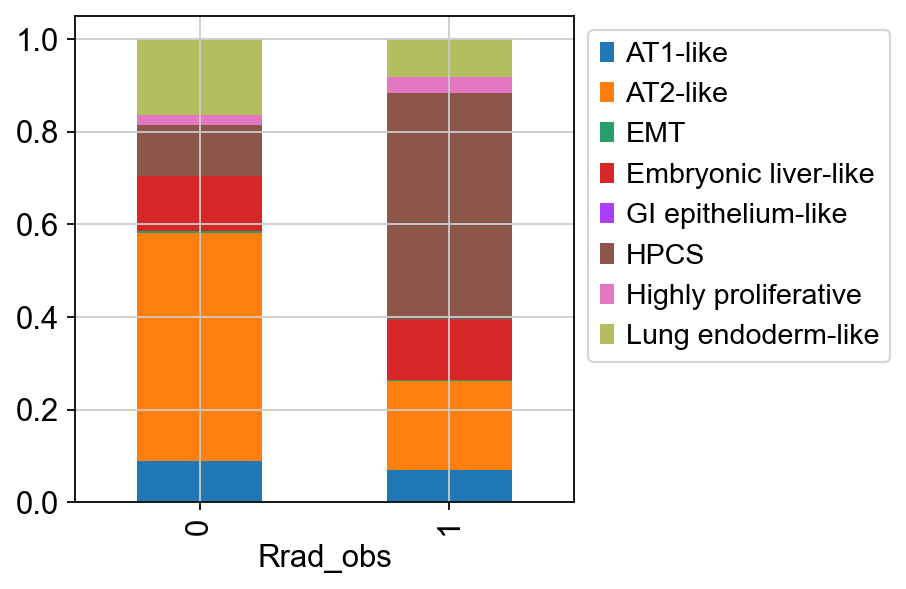

In [146]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Rrad_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [147]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Rrad_cell_type.svg')

### Quantify Tnf expression in HPCS vs other Clusters in single cell data

In [148]:
adata.obs['Tnf_obs'] = [1 if x else 0 for x in adata[:,'Tnf'].X != adata[:,'Tnf'].X.min()]

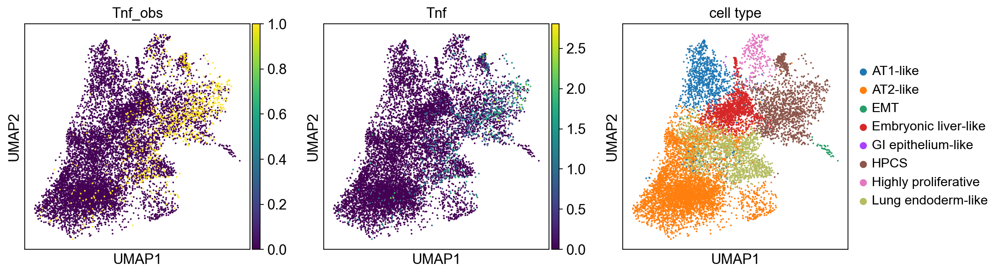

In [149]:
sc.pl.umap(adata, color=['Tnf_obs', 'Tnf','cell type'])

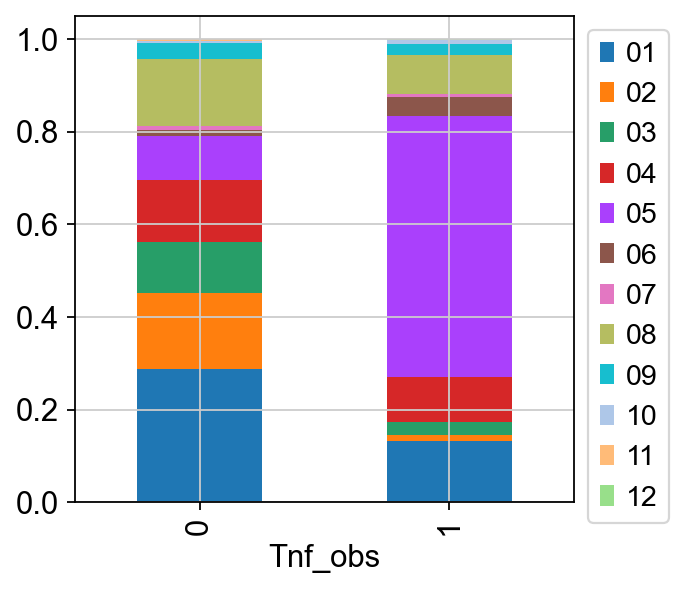

In [150]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Tnf_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [151]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Tnf_10x.svg')

In [152]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Tnf_obs'], normalize='columns')

Tnf_obs,0,1
clusterK12,,
01,0.288296,0.132335
02,0.163421,0.013733
03,0.109315,0.026217
04,0.135013,0.097378
05,0.093656,0.564295
06,0.013250,0.041199
07,0.010038,0.006242
08,0.143345,0.084894
09,0.035334,0.023720


In [153]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Tnf_obs'])

Tnf_obs,0,1
clusterK12,,
01,2872,106
02,1628,11
03,1089,21
04,1345,78
05,933,452
06,132,33
07,100,5
08,1428,68
09,352,19


In [154]:
pd.crosstab(adata.obs['cell type'],adata.obs['Tnf_obs'], normalize='columns')

Tnf_obs,0,1
cell type,,
AT1-like,0.093756,0.017478
AT2-like,0.497792,0.121099
EMT,0.003614,0.000000
Embryonic liver-like,0.122566,0.079900
GI epithelium-like,0.000301,0.000000
HPCS,0.103192,0.575531
Highly proliferative,0.021682,0.037453
Lung endoderm-like,0.157097,0.168539


In [155]:
pd.crosstab(adata.obs['cell type'],adata.obs['Tnf_obs'])

Tnf_obs,0,1
cell type,,
AT1-like,934,14
AT2-like,4959,97
EMT,36,0
Embryonic liver-like,1221,64
GI epithelium-like,3,0
HPCS,1028,461
Highly proliferative,216,30
Lung endoderm-like,1565,135


In [156]:
pd.crosstab(adata.obs['cell type'],adata.obs['Tnf_obs']).sum()

Tnf_obs
0    9962
1     801
dtype: int64

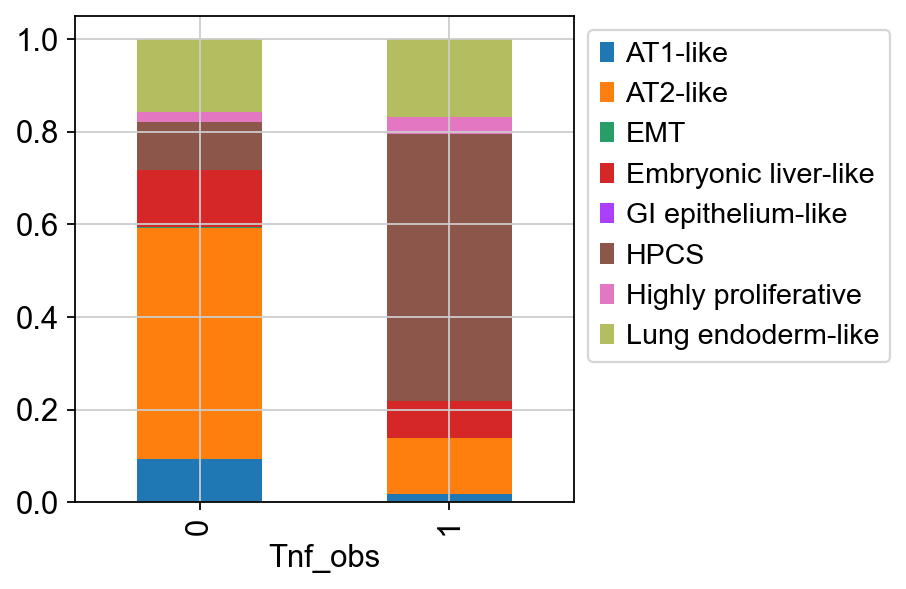

In [157]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Tnf_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [158]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Tnf_cell_type.svg')

### Quantify Abtb2 expression in HPCS vs other Clusters in single cell data

In [159]:
adata.obs['Abtb2_obs'] = [1 if x else 0 for x in adata[:,'Abtb2'].X != adata[:,'Abtb2'].X.min()]

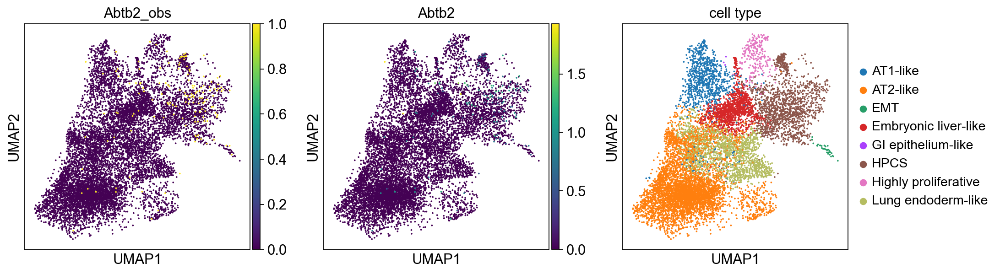

In [160]:
sc.pl.umap(adata, color=['Abtb2_obs', 'Abtb2','cell type'])

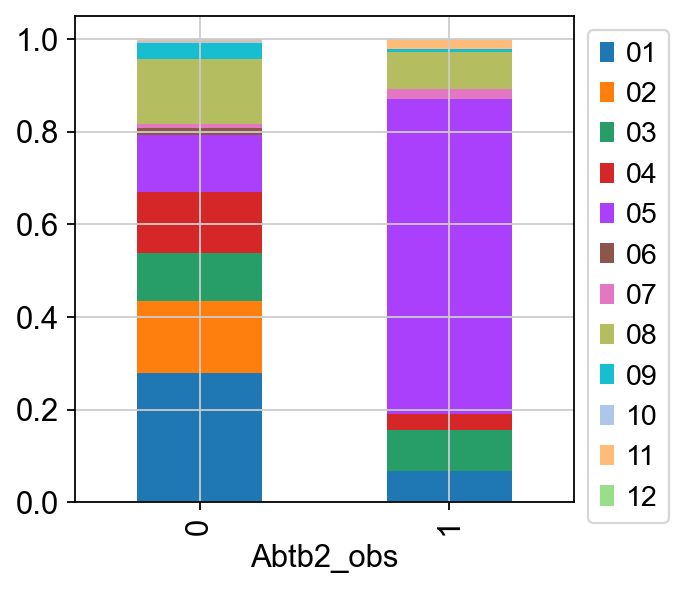

In [161]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Abtb2_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [162]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Abtb2_10x.svg')

In [163]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Abtb2_obs'], normalize='columns')

Abtb2_obs,0,1
clusterK12,,
01,0.279578,0.068027
02,0.154390,0.000000
03,0.103335,0.088435
04,0.133572,0.034014
05,0.121044,0.680272
06,0.015543,0.000000
07,0.009608,0.020408
08,0.139789,0.081633
09,0.034853,0.006803


In [164]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Abtb2_obs'])

Abtb2_obs,0,1
clusterK12,,
01,2968,10
02,1639,0
03,1097,13
04,1418,5
05,1285,100
06,165,0
07,102,3
08,1484,12
09,370,1


In [165]:
pd.crosstab(adata.obs['cell type'],adata.obs['Abtb2_obs'], normalize='columns')

Abtb2_obs,0,1
cell type,,
AT1-like,0.088263,0.074830
AT2-like,0.475038,0.088435
EMT,0.003109,0.020408
Embryonic liver-like,0.119725,0.095238
GI epithelium-like,0.000283,0.000000
HPCS,0.131123,0.659864
Highly proliferative,0.022607,0.040816
Lung endoderm-like,0.159853,0.020408


In [166]:
pd.crosstab(adata.obs['cell type'],adata.obs['Abtb2_obs'])

Abtb2_obs,0,1
cell type,,
AT1-like,937,11
AT2-like,5043,13
EMT,33,3
Embryonic liver-like,1271,14
GI epithelium-like,3,0
HPCS,1392,97
Highly proliferative,240,6
Lung endoderm-like,1697,3


In [167]:
pd.crosstab(adata.obs['cell type'],adata.obs['Abtb2_obs']).sum()

Abtb2_obs
0    10616
1      147
dtype: int64

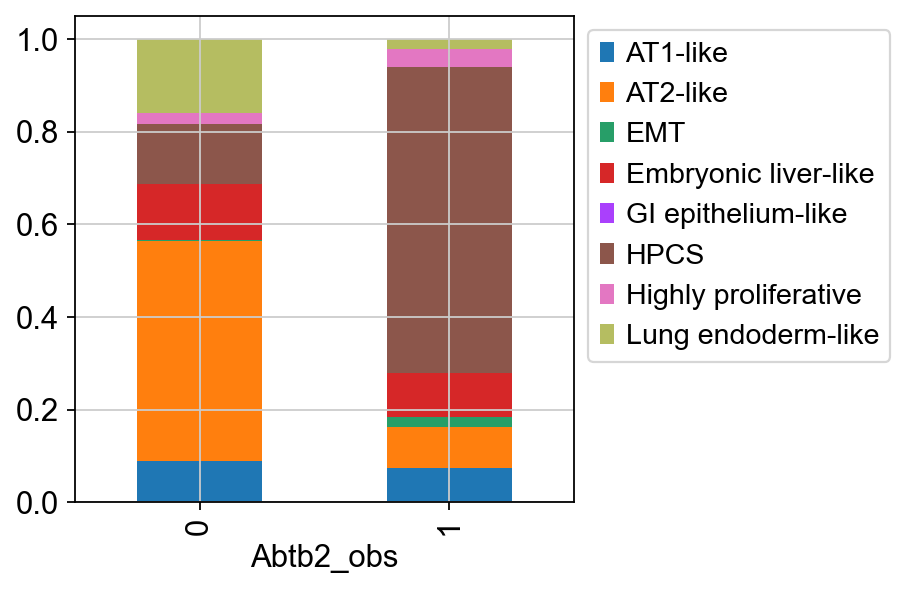

In [168]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Abtb2_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [169]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Abtb2_cell_type.svg')

### Quantify Pnp2 expression in HPCS vs other Clusters in single cell data

In [170]:
adata.obs['Pnp2_obs'] = [1 if x else 0 for x in adata[:,'Pnp2'].X != adata[:,'Pnp2'].X.min()]

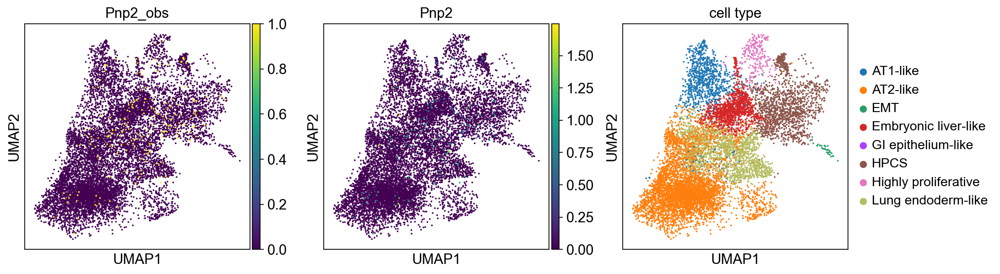

In [171]:
sc.pl.umap(adata, color=['Pnp2_obs', 'Pnp2','cell type'])

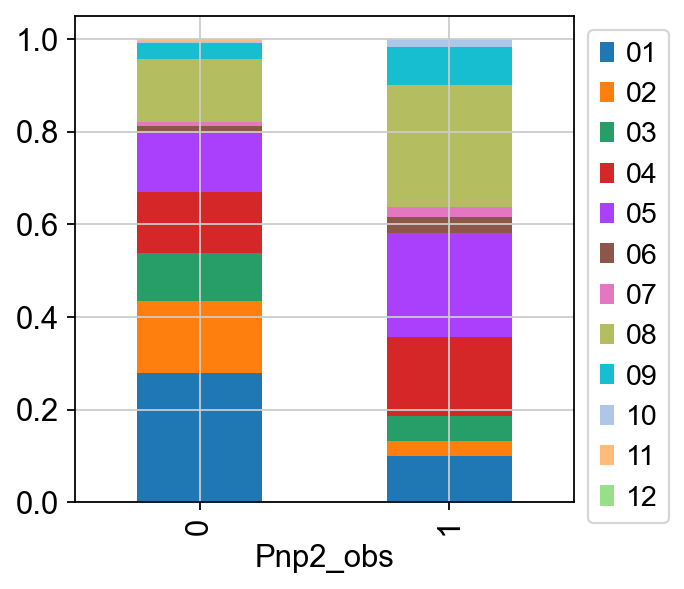

In [172]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Pnp2_obs'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [173]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_Pnp2_10x.svg')

In [174]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Pnp2_obs'], normalize='columns')

Pnp2_obs,0,1
clusterK12,,
01,0.279747,0.098901
02,0.154333,0.032967
03,0.103960,0.054945
04,0.131557,0.170330
05,0.127020,0.225275
06,0.015027,0.032967
07,0.009545,0.021978
08,0.136849,0.263736
09,0.033645,0.082418


In [175]:
pd.crosstab(adata.obs['clusterK12'],adata.obs['Pnp2_obs'])

Pnp2_obs,0,1
clusterK12,,
01,2960,18
02,1633,6
03,1100,10
04,1392,31
05,1344,41
06,159,6
07,101,4
08,1448,48
09,356,15


In [176]:
pd.crosstab(adata.obs['cell type'],adata.obs['Pnp2_obs'], normalize='columns')

Pnp2_obs,0,1
cell type,,
AT1-like,0.088744,0.049451
AT2-like,0.474908,0.170330
EMT,0.003402,0.000000
Embryonic liver-like,0.117758,0.214286
GI epithelium-like,0.000284,0.000000
HPCS,0.135904,0.280220
Highly proliferative,0.022682,0.032967
Lung endoderm-like,0.156318,0.252747


In [177]:
pd.crosstab(adata.obs['cell type'],adata.obs['Pnp2_obs'])

Pnp2_obs,0,1
cell type,,
AT1-like,939,9
AT2-like,5025,31
EMT,36,0
Embryonic liver-like,1246,39
GI epithelium-like,3,0
HPCS,1438,51
Highly proliferative,240,6
Lung endoderm-like,1654,46


In [178]:
pd.crosstab(adata.obs['cell type'],adata.obs['Pnp2_obs']).sum()

Pnp2_obs
0    10581
1      182
dtype: int64

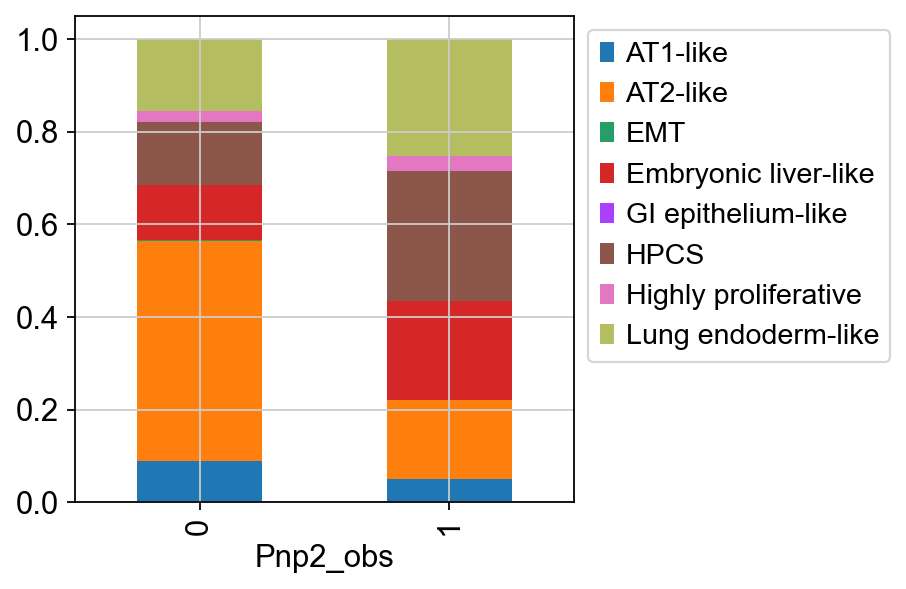

In [179]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Pnp2_obs'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))

In [180]:
cell_proportion_df.get_figure().savefig('figures/Revision_1_cell_proportion_10x_Pnp2_cell_type.svg')

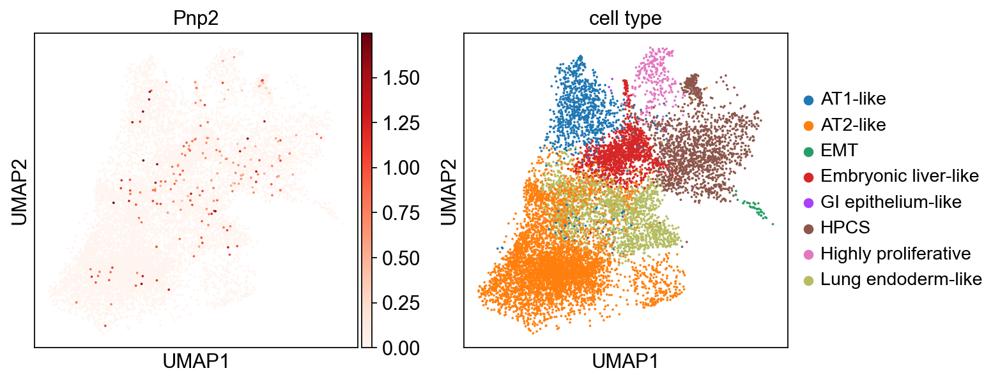

In [181]:
sc.pl.umap(adata, color=['Pnp2','cell type'],cmap='Reds')

## Reload Tumor Cell Data

In [182]:
adata = load('write/combined_data_with_DT.joblib')

In [183]:
# Select relevant datasets
adata = adata[adata.obs.Group.isin(['Saline','DT_7d']),:]

In [184]:
Path("./figures/matrixplot_figures/").mkdir(parents=True, exist_ok=True) # generate matrix plot figure here (maybe a bug in SCANPY)

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/_core/anndata.py:1301: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/_core/anndata.py:1301: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/_core/anndata.py:1301: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/_core/anndata.py:1301: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


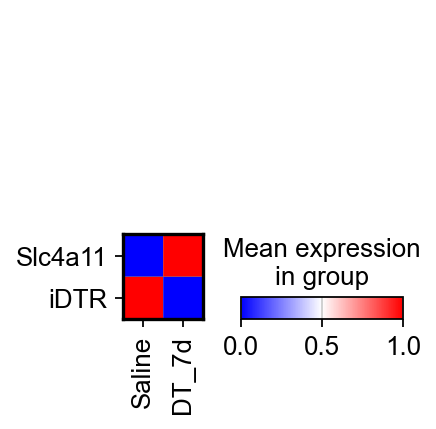

In [185]:
#Slc4a11 enriches after 7-day DT treatment suggesting selection against DTR allele and likely incomplete recombination of original allele
sc.pl.matrixplot(adata,['Slc4a11','iDTR'],'Group',cmap='bwr', swap_axes=True, categories_order=['Saline','DT_7d'],standard_scale='var',save='figures/Ext_Data_Fig7c_DT_heatmap_scaled.svg')

In [186]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group   Classification
DT_7d   BA1893_B0307       299
        BA1894_B0308       212
        BB1880_B0309       563
        BC1194_B0307      1281
        BD1219_B0310      1062
        BD1290_B0311       759
        BD1508_B0308      1471
Saline  BA1892_B0301      2179
        BA1931_B0302      2178
        BC1192_B0303      2137
        BC1193_B0301      1185
        BD1284_B0302      1444
        BD1286_B0303      1640
Name: count, dtype: int64